# Fake Job Description Prediction

## About Data:
This dataset contains 18K job descriptions out of which about 800 are fake. The data consists of both textual information and meta-information about the jobs. The dataset can be used to create classification models which can learn the job descriptions which are fraudulent.

### Importing basic libraries

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

### Importing dataset 

In [2]:
data = pd.read_csv("D:/dataforpython/fake_job_postings.csv")

### Overview of data

In [3]:
data.head()
data = data.drop(["job_id"],axis=1)      # <----- Droping job_id column as it is not required.

# Descriptive Statistics 
data.describe()

# Shape of the data
data.shape

# Info about data
data.info

<bound method DataFrame.info of                                                    title  \
0                                       Marketing Intern   
1              Customer Service - Cloud Video Production   
2                Commissioning Machinery Assistant (CMA)   
3                      Account Executive - Washington DC   
4                                    Bill Review Manager   
...                                                  ...   
17875                   Account Director - Distribution    
17876                                 Payroll Accountant   
17877  Project Cost Control Staff Engineer - Cost Con...   
17878                                   Graphic Designer   
17879                         Web Application Developers   

                   location   department salary_range  \
0          US, NY, New York    Marketing          NaN   
1            NZ, , Auckland      Success          NaN   
2             US, IA, Wever          NaN          NaN   
3        US, DC, Wa

### Creating copy of data for EDA

In [4]:
data1 = data.copy()

## EDA 
### Fake job postings based on employment type

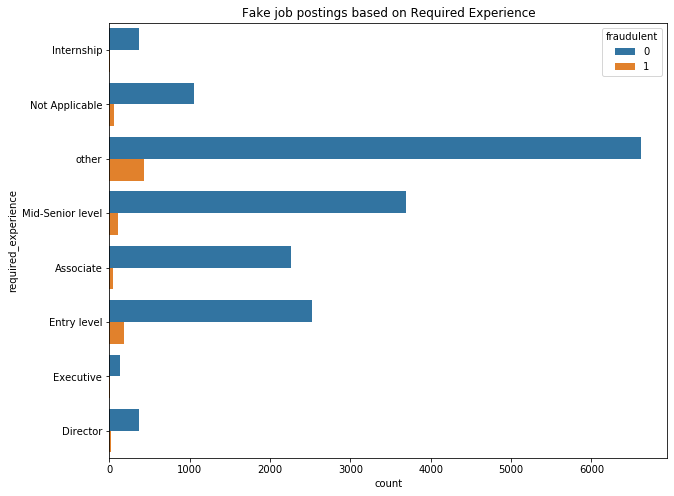

In [5]:
data1['required_experience'] = data1['required_experience'].fillna(value='other')
plt.figure(figsize=(10,8))
sns.countplot(hue='fraudulent',y='required_experience',data=data1)
plt.title("Fake job postings based on Required Experience")
plt.show()

### Fake job postings based on required experience

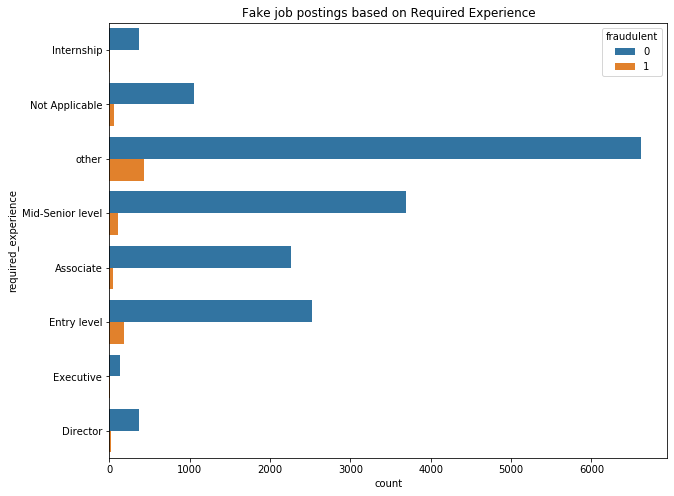

In [6]:
data1['required_experience'] = data1['required_experience'].fillna(value='other')
plt.figure(figsize=(10,8))
sns.countplot(hue='fraudulent',y='required_experience',data=data1)
plt.title("Fake job postings based on Required Experience")
plt.show()

### Fake job postings based on Required Education

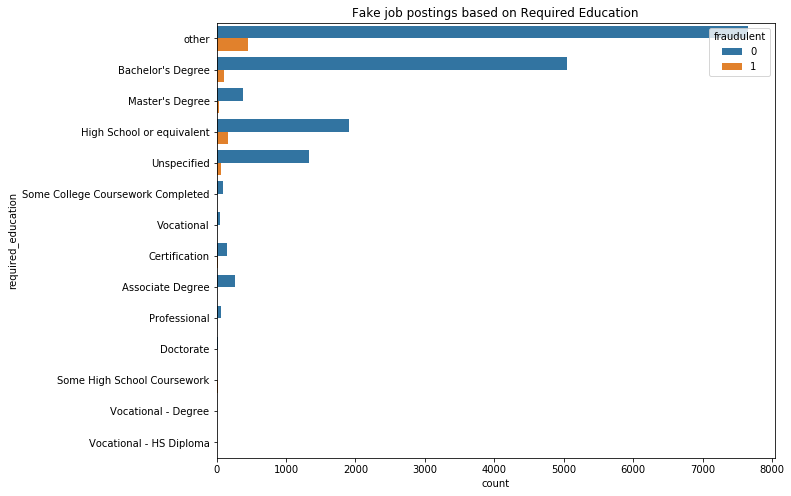

In [7]:
data1['required_education'] = data1['required_education'].fillna(value='other')
plt.figure(figsize=(10,8))
sns.countplot(hue='fraudulent',y='required_education',data=data1)
plt.title("Fake job postings based on Required Education")
plt.show()

### Fake job postings based on industry

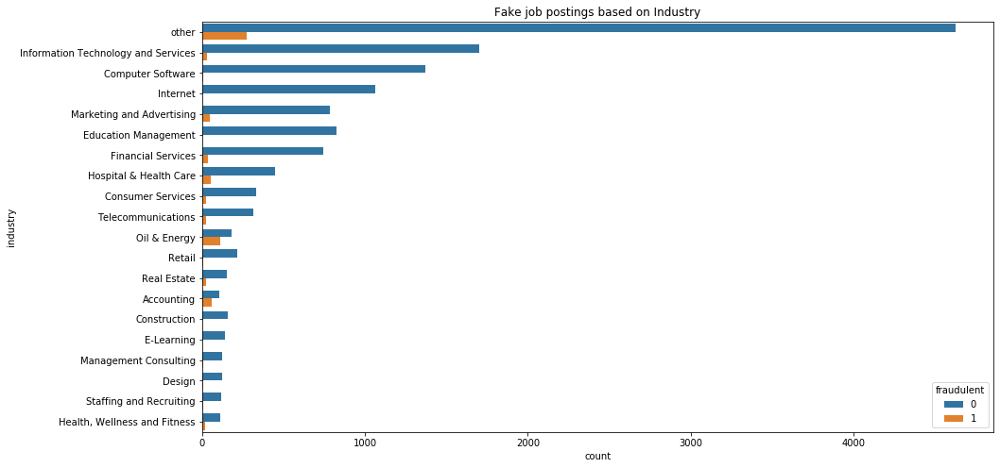

In [8]:
data1['industry'] = data1['industry'].fillna(value='other')
plt.figure(figsize=(15,8))
sns.countplot(hue='fraudulent',y= 'industry',data=data1,order=data1.industry.value_counts().iloc[:20].index)
plt.title("Fake job postings based on Industry")
plt.show()

### NA values present in the data

In [9]:
data.isna().sum()

title                      0
location                 346
department             11547
salary_range           15012
company_profile         3308
description                1
requirements            2695
benefits                7210
telecommuting              0
has_company_logo           0
has_questions              0
employment_type         3471
required_experience     7050
required_education      8105
industry                4903
function                6455
fraudulent                 0
dtype: int64

As salary_range column has 15012 NA records and also we cannot directly assume any salary range,
as different companies may have different salary range.
Dropping salary_range column.

In [11]:
data = data.drop(["salary_range"],axis=1)

KeyError: "['salary_range'] not found in axis"

### Joining every column containing strings(text) so that we can apply basic NLP techniques to convert data into int. Filling NA values with blanks i.e " "

In [12]:
data.fillna(" ",inplace=True)

In [13]:
# checking if there are any NA values
data.isna().sum()

title                  0
location               0
department             0
company_profile        0
description            0
requirements           0
benefits               0
telecommuting          0
has_company_logo       0
has_questions          0
employment_type        0
required_experience    0
required_education     0
industry               0
function               0
fraudulent             0
dtype: int64

### Joining String present in each column togethere except columns ("telecomputing", "has_comapny_logo", "has_questions", "fraudlent")

In [14]:
data["string"] = data['title'] + ' ' + data['location'] + ' ' + data['department'] + ' ' + data['company_profile'] + ' ' + data['description'] + ' ' + data['requirements'] + ' ' + data['benefits'] + ' ' + data['employment_type'] + ' ' + data['required_education'] + ' ' + data['industry'] + ' ' + data['function'] 

In [15]:
# sample of data["string"], to view if it is done correctly
data.string[0]

"Marketing Intern US, NY, New York Marketing We're Food52, and we've created a groundbreaking and award-winning cooking site. We support, connect, and celebrate home cooks, and give them everything they need in one place.We have a top editorial, business, and engineering team. We're focused on using technology to find new and better ways to connect people around their specific food interests, and to offer them superb, highly curated information about food and cooking. We attract the most talented home cooks and contributors in the country; we also publish well-known professionals like Mario Batali, Gwyneth Paltrow, and Danny Meyer. And we have partnerships with Whole Foods Market and Random House.Food52 has been named the best food website by the James Beard Foundation and IACP, and has been featured in the New York Times, NPR, Pando Daily, TechCrunch, and on the Today Show.We're located in Chelsea, in New York City. Food52, a fast-growing, James Beard Award-winning online food communi

### After joining all column which contain text we can now drop the columns which we used to join.

In [16]:
data = data.drop(['title'],axis=1)
data = data.drop(['location'],axis=1)
data = data.drop(['department'],axis=1)
data = data.drop(['company_profile'],axis=1)
data = data.drop(['description'],axis=1)
data = data.drop(['requirements'],axis=1)
data = data.drop(['benefits'],axis=1)
data = data.drop(['employment_type'],axis=1)
data = data.drop(['required_experience'],axis=1)
data = data.drop(['required_education'],axis=1)
data = data.drop(['industry'],axis=1)
data = data.drop(['function'],axis=1)

In [17]:
# Overview of data
data.head()

,telecommuting,has_company_logo,has_questions,fraudulent,string
0,0,1,0,0,"Marketing Intern US, NY, New York Marketing We..."
1,0,1,0,0,"Customer Service - Cloud Video Production NZ, ..."
2,0,1,0,0,"Commissioning Machinery Assistant (CMA) US, IA..."
3,0,1,0,0,"Account Executive - Washington DC US, DC, Wash..."
4,0,1,1,0,"Bill Review Manager US, FL, Fort Worth SpotS..."


### Checking if the data is imbalanced

In [18]:
data["fraudulent"].value_counts()

0    17014
1      866
Name: fraudulent, dtype: int64

### Handling imbalance data (upscaling data)

In [19]:
from sklearn.utils import resample

df_majority = data[data['fraudulent'] == 0]
df_majority = df_majority.head(6000)
df_minority = data[data['fraudulent'] == 1]

upSample = resample(df_minority, replace=True, n_samples=6000, random_state=0)

data = pd.concat([df_majority, upSample])
data['fraudulent'].value_counts()

1    6000
0    6000
Name: fraudulent, dtype: int64

### Cleaning the text data from data["string"] column

In [20]:
# importing libraries for cleaning
import nltk
import re
import string
from nltk.stem import PorterStemmer
from nltk.stem import WordNetLemmatizer
from nltk.corpus import stopwords

In [21]:
# creating object of porterstemmer, WordNetLemmatizer & stopwords
stemmer = PorterStemmer()
lemmatizer = WordNetLemmatizer()
stopwords = set(stopwords.words('english'))

In [22]:
# checking length of stop words
len(stopwords)

179

In [23]:
# Adding puntuation to set of stopwords
punctuation = list(string.punctuation)
stopwords.update(punctuation)

In [24]:
# checking length after adding puntuation to stopwords
len(stopwords)

211

In [25]:
# Resetting index as upscaling will give random numbers.
data = data.reset_index(drop=True)

In [26]:
# Cleaning text
doc = []
for i in range(0,data.shape[0]):
    text = str(data["string"][i])
    text = text.lower()
    text = re.sub("[^a-zA-Z]", " ", text)
    text = nltk.word_tokenize(text)
    text = [lemmatizer.lemmatize(word) for word in text if word not in stopwords]
    text = " ".join(text)
    print(text)
    doc.append(text)

0
marketing intern u ny new york marketing food created groundbreaking award winning cooking site support connect celebrate home cook give everything need one place top editorial business engineering team focused using technology find new better way connect people around specific food interest offer superb highly curated information food cooking attract talented home cook contributor country also publish well known professional like mario batali gwyneth paltrow danny meyer partnership whole food market random house food named best food website james beard foundation iacp featured new york time npr pando daily techcrunch today show located chelsea new york city food fast growing james beard award winning online food community crowd sourced curated recipe hub currently interviewing full part time unpaid intern work small team editor executive developer new york city headquarters reproducing repackaging existing food content number partner site huffington post yahoo buzzfeed various conte

intensive case management worker bilingual essential ca ottawa icm since working together make community healthygood health mean treating people sick problem like poverty addiction family violence bring illness keep people getting well sandy hill community health centre treat illness arises also work hard create healthy community people stay well get life believe integrity respect equity collaboration empathy applying posting hereby acknowledge information provide collected url c b f bf c ce bb bbd f dea term privacy policy http url c b f bf c ce bb bbd f dea privacy candidate hired shchc employee provide data separate process subject shchc privacy confidentiality policy procedure depuis travailler ensemble pour une communaut en sant une bonne sant signifie plus que de soigner le gen lorsqu il sont malades de probl me comme la pauvret la pendance la violence familiale peuvent causer la maladie ou emp cher le gen de se r tablir au centre de sant communautaire c te de sable nous traitons

customer service associate ca ab edmonton novitex enterprise solution formerly pitney bowes management service delivers innovative document communication management solution help company around world drive business process efficiency increase productivity reduce cost improve customer satisfaction almost year client turned u integrate optimize enterprise wide business process empower employee increase productivity maximize result trusted partner continually focus delivering secure technology enabled document communication solution improve client work process enhance customer interaction drive growth customer service associate based edmonton alberta right candidate integral part talented team supporting continued growth responsibility ability learn provide back print service receiving mail perform various mail center activity sorting metering folding inserting delivery pickup etc lift heavy box file paper neededmaintain highest level customer care demonstrating friendly cooperative attit

helpdesk specialist nz n auckland callcentre people recruitment recognised specialist within callcentre industry provide permanent temporary contract management staff number large national multi national business various industry client requires helpdesk specialist assist school resolving issue arrive network top service working collaboratively school vendor tech successful candidate passionate development technology educational tool nz ability explain technical issue concise non technical manner written verbal customer service focus relevant industry qualification network pragmatic approach solving problem comfortable dealing occasional explicit extreme content troubleshooting filtering issue mature approach good coping strategy main responsibility position professionally proactively handle request customer ensure issue resolved promptly thoroughly focus getting best possible outcome customer call centre statistic thoroughly efficiently gather customer information fulfill customer nee

financial accountant u ny new york finance shapeways leading printing marketplace community empowering designer bring amazing product life giving anyone ability quickly affordably turn idea digital design real product shapeways fundamentally changing product made shapeways designer gain access best industrial printing technology capable manufacturing product complex design wide range high quality material printing turn raw material original product wedding ring rocketships model train iphone case prototype industrial engineering part shapeways community sell product share idea get feedback creative consumer designer around world headquartered new york shapeways factory office eindhoven queen seattle shapeways spin lifestyle incubator royal philip electronics investor include union square venture index venture lux capital andreessen horowitz shapeways fast growing global startup goal making printing accessible affordable everything make custom tailored customer wish want help deliver ex

global sourcing buyer u fl orlando marketmaker leadership team extensive experience e procurement online auction market intelligence strategic sourcing supply chain consulting team member involved e enablement supply chain negotiation since inception industry marketmaker international company office u uk australia china uae philosophy encourage enable use online auction negotiation technique developing proprietary software sophisticated functionality also easy use due intuitive design course software useless used properly support service integral approach esourcing company include provision marketmaking service within subscription also focused ensuring client timely access advisory expertise market intelligence business insight achieve positive successful online auction negotiation experience marketmaker bid neutral provides confidential e auction service event host bidder promote success every party involved electronic auction negotiation event cross functional role focus operational 

sr accountant u pa philadelphia accounting weblinc e commerce platform service provider fastest growing online retailer weblinc modern agile technology strategic expertise empower company running global omnichannel commerce operation enable retailer consistently pace competition industry leading ecommerce platform enables u create solution unique reflection brand customer experience want weblinc natural choice nasty gal high fashion retailer w diamond group purveyor iconic traditional american apparel brand healthy direction chose weblinc sell technology averse customer base deep discount used weblinc design develop site base tech savvy customer always start getting online shopping experience exactly right start weblinc back merchandising tool increase traffic page view discount promotion engine lead higher conversion recurring order tool drive sale easy repeat purchasing mention innovative mobile social integration capability let face ecommerce second act capturing holding customer fi

english teacher abroad u ut logan help teacher get safe amp secure job abroad play kid get paid love travel job asia usd monthly cost living housing provided private furnished airfare reimbursedexcellent student loan credit cardsgabriel adkins url ed c b f e cdb decc dd cfd f url db f c db e c fc ab ea ac b f e b month contract apply today university degree required tefl tesol celta teaching experience preferred necessarycanada u passport holder see job description contract bachelor degree education management
506
referants source u national jeri davis internationalwe distinguished year combined experience senior level consultant associate jdi hand experience provides unparalleled depth breadth healthcare knowledge networking capability contact bring every assignment jdi stand apart due result achieved confidence client develop working u jdi year success record service recruit top notch executive quickly efficientlyaccelerate revenue total solution revenue enhancement program create fi

project engineer za nl richards bay ensight international energy design implementation practice specialising sophisticated whole business energy efficiency program energy intensive industry working global enterprise innovative world leading program require people passion efficiency collaborative teamwork economic optimisation delivery rapid result enduring profitable client work part high performance team implementing ensight innovative energy leadership program delivering energy cost saving south africa resource sector working closely industrial client reveal design implement enduring energy cost saving initiative deliver sustainable value client business work project ranging across energy type electricity diesel petroleum fuel oil coal gas waste heat hydro solar aspect energy cost business procurement sale optimisation substitution etc download job profile qualification requirementsregistered capable registered professional engineer energy efficiency qualification bachelor degree ele

sr software engineer u ca el segundo technology consumertrack technology centric internet marketing company built culture excellence preferred digital advertiser premium financial brand american express discover allstate equifax website set vision strategy client reach connect target audience consumertrack pride team exudes leadership high initiative creativity passion joining team opportunity maximize job performance satisfaction company constantly growing committed recruit retain promote employee diversity background life experience believe diversity foster growth innovation ensuring remain industry leader currently looking energetic driven entrepreneurial trendsetters area url cb ac dbe cfc b e bbb f looking advance career become part team invite apply open position consumertrack rapidly growing internet marketing company technology innovation core business model network website built reputation preferred digital advertiser premium financial brand like american express discover alls

front end web developer cs html gb inviting inspirational individualswe fast becoming world class company making massive impact charity looking top talent join growing london nottingham office reason work raising part fast moving tech companywe love driving forward innovation everyone team contributes ideaswe still small team making big difference work leading charitiesour client list includes leading charity rspca macmillan unicefearn would elsewhere make million cause count make massive impact worldthe charity space really struggling government funding decreasingthe future web social medium leading way huge opportunity jobwe onto something big big part corporate clogour product already hugely successful beginning join great fun friendly teamour team driven difference makingwe passionate people know work hard good time help charity transform life million people need online fundraising tool make easy create viral social campaign cause really matter join u help raise money vital cause w

player insight analyst gb lnd london analytics space ape game award winning mobile social gaming startup founded small high performing team big aspiration make highest quality successful game smart phone tablet believe trait nearly successful game mobile tablet common made talented team lot experience working together ten thousand app developer handful really good really experienced well gelled team accordingly everyone team player deep gaming experience key guy gal behind biggest game facebook internet team behind game facebook two game facebook one biggest virtual world kid planet samurai siege u top grossing app top country played people first month since launch love great tech sake make game big audience mean got work time competitive space mean need fast efficient serious sprint management good game keep u focused creative company tempered great analytics smart analytics make good game even better think analytics alone make soulless product choose one space ape san francisco style

resume submitted job valorservices com u valor service provides workforce solution meet need company across private sector special focus oil amp gas industry valor service involved throughout every step hiring process remain contact way final step signing employment contract new employer valor service founded vision employing unique skill experience quality america finest veteran provide private sector company precise concerted value added service america finest veteran optimized career opportunity eager get word veteran ample opportunity employment private sector ideal candidate fill position valor service success mission candidate submits resume email f c da dde f ce f e cf b ad f
799
graduate english teacher abroad u ok oklahoma city help teacher get safe amp secure job abroad play kid get paid love travel job asia usd monthly cost living housing providedairfare reimbursedexcellent student loan credit cardsgabriel adkins url ed c b f e cdb decc dd cfd f url db f c db e c fc ab ea ac

technical lead io ap hyderabad engineering work mutual mobile craft beautiful mobile interface solve complex software challenge client audi cisco jaguar land rover google come u deep experience mobile establishing mobile strategy provides impactful business value building solution ground bring together brightest mind creative engineering business deliver solution actually matter technical lead mutual mobile lead engineer mentor io team build advocate delightful user experience io guide project team creating technical design writing user story managing prioritizing team development task promote champion best technical practice client team help manage customer relationship evaluate contribute open source project perform code review triage bug manage release proactively drive innovation within company excel position least year development experience least year experience building application io experience working objective c xcode instrument skilled debugging working knowledge core io fra

provision ecommerce intern provision food created groundbreaking award winning cooking site support connect celebrate home cook give everything need one place top editorial business engineering team focused using technology find new better way connect people around specific food interest offer superb highly curated information food cooking attract talented home cook contributor country also publish well known professional like mario batali gwyneth paltrow danny meyer partnership whole food market random house food named best food website james beard foundation iacp featured new york time npr pando daily techcrunch today show located chelsea new york city ob great product stylish delicious first among friend spot handsome swedish linen know artisan jam maker selling small batch marmalade house find constantly patrolling site like svpply herriott grace kaufmann mercantile search latest best stuff table kitchen answer question yes read url ee fdb b ee f aa adbc edbdf community people love

project manager software web development u ca san diego pint leader web industry year web design software development consulting experience pint principal also founder two software company zingchart port software build site application leading organization california u worldwide help move industry forward book instruction university conference participation pint culturefrom keyboard bashing coder creative caffeine driven web aficionado pint day go employee learning teaching continually technically professionally challenged amount experience knowledge co worker share often crash course advanced web development software engineering principle conference room wall tiled post note mosaic user interview question printed web dev decoupage throughout office poise pint bleeding edge exactly want foodie focused friday morning often highly anticipated enjoyed among member weekly pint breakfast club pint seeking detail oriented impassioned individual love online experience join team project manage

branch circulation clerk u fl apopka north orange great benefitscompetitive pay summary general supervision performs variety public service duty involving automated circulation system function essential function class specification list major duty requirement job inclusive incumbent may expected perform job related duty contained document may required specific job related knowledge skill customer servicedemonstrates courteous cooperative behavior interacting public staff act manner promotes harmonious effective workplace environment provides public service circulation desk include checking library material maintaining patron account collection fine fee registering issuing patron card assist patron discovery library material library equipment library resource answer inquiry customer refers depth inquires assist patron question regarding library account performs routine shelf check material assist patron computer related service library computer system database personal digital device on

accountant u ny farmingdale year nac marketing company llc b new vitality helped people healthy live better marketing selling vitamin health supplement personal care product customer learn product direct marketing advertisement use celebrity athlete doctor promote radio television station across north america offer wide variety career entry level position well internship fast paced exciting industry employee hold position marketing creative ecommerce medium buying product development accounting human resource operation inbound amp outbound sale new york california office work healthywe believe philosophy healthy live better customer especially employee encourage healthier lifestyle affordable benefit gym reimbursement program medical insurance company event promote physical activity company morale affordable medical dental amp vision insuranceflexible spending account amp dependent carecompany paid life insurance amp long term disabilityemployee discount new vitality product work bette

creative lead gb lnd creative augmented reality job go one blippar hard beat rapidly expanding creative startup forefront brand new industry working offer real opportunity shape innovative technology way people use like working imaginative people think outside box love people throw whole box away build something completely new bright open centrally located office energetic environment bursting collaborative idea boundless enthusiasm aside part exciting driven super friendly team nurture talent help grow blippar find plenty tangible benefit including weekly free lunch evening drink olive office dog also working intimately start world biggest brand coca cola nestle conde nast p amp g jaguar young growing company spearheading exciting augmented reality industry biggest perk creative control afforded whether part design tech commercial marketing team think people amazing want stick around creative lead responsibility delivering client account project creative linchpin expected lead deliver

web developer gr athens technology young dynamic fast growing digital marketing agency established february headquartered athens greece storyteller combine strategy creativity technology order create user centric campaign think digital brand builder team comprised individual great experience digital communication strategic marketing offer client service cover entire spectrum brand existence across digital channel mission create world class interactive experience empower audience connect share thus deliver measurable result creative innovation looking next passionate member team create interesting innovative thing together interweave seeking web developer technologist develop execute project across platform channel product platform website mobile campaign collaborate strategist marketer information architect ux designer copywriter build great brand experience online goal part job create user centric campaign highly engaging exceed client expectation objective ideal candidate bring solid

associate business development gb work home want build career free training exchange time revenue share basiswe startup providing global service well known organization busy due overwhelming response looking expand want create network associate focus innovative product business development client management area exchange provide assistance training improve career prospect experience working u launch pad help succeed career long term potential area help learning new programming language learning new open source platform e g wordpress joomla exposure building ecommerce solution seo etc interacting senior decision maker sale marketingplease send cvlooking forward hearing full time information technology service business development
1285
developer gr athens general descriptionandroid application development integrated mobile solution responsibilitiesapplication development project undertaking responsibility relevant experience required technical business skill knowledge least year relevant

business development director gb lnd london hedgehog lab post pc digital agency architect design develop market apps amp digital solution phone tablet tv kiosk amp post pc device help brand amp enterprise prepare future dominated post pc technology specialise working client innovation amp r amp mobile amp emerging platform hedgehog lab growth trajectory looking experienced business development director help u deliver great product amp digital solution customer across globe due rapid expansion past year opened office london last year look someone spearhead sale amp client service effort office role also involve fair amount travel newcastle upon tyne primary production team based goal best post pc digital agency uk building designing great software ftse amp fortune company global aspiration already work client europe asia america need someone help u spread wing accelerate growth moving figure project figure project amp fairly flat organisation fluid responsibility within team member role

office assistant gb lnd london finance operation stylistpickstylistpick venture backed social commerce company launched uk dec today countsover registered member usps center around curation personalization leverage celebrity social medium property authentically online stylistpick currently count cheryl cole louise roe mlle agnes france gala gonzalez spain celebrity influencers stylistpick recently expanded france launch apr spain launch jul continue expansioninto europe stylistpick founded serial entrepreneur felix leuschner backed venture capital fund index venture accel partner fidelity growth partner europe growing strongly since launch stylistpick raised date varied role working across whole business suit team player efficient worker highly organized want get know variety process across several team fast growing fashion e commerce startup role involve certainly limited following office adminprovide first point contact office visitor delivery look visitor make feel welcomenotify rel

food beverage guest relation alexandria egypt eg optimal business action created order provide high quality personalized hr service medium large cap company operating greece balkan middle east seven year later present athens bucharest dubai several company client list including major bank pharmaceutical hotel amp retail chain large firm one nine hr firm greece operating temping permit issued labor ministry among offer employee evaluation based combination minnesota multiphasic personality inventory mmpi rorschach test amongst advantage extensive candidate network use industry specialized recruiter technology tool including candidate pre recorded interview competitive success fee structure subsidiary creative hr created order undertake human capital intensive project hr department restructurings provide hr consulting service itechscope recruitment created first international recruitment company greece specializing sourcing placing personnel company operating field information technology

head demand sale emea gb london sale axonix global mobile advertising technology company powered platform year history leading market using technology acquired mobclix world first rtb enabled mobile ad exchange axonix offer fully transparent programmatic trading platform enables publisher sell mobile advertising inventory real time brand agency ad network globally serve billion ad per month across country working demand partner globally achieve industry leading cpms ctrs fill rate built fraud detection control data driven targeting option help advertiser secure optimal ad inventory deliver best campaign result axonix headquartered central london backed telefonica private equity group blackstone philosophy hiringour technology serf billion mobile ad every month across country company truly global scale growing fast need hire best people people thrive fresh challenge people want see work make impact right away people demand lot others hire someone sure better person job better person rat

account manager u pa philadelphia project management weblinc e commerce platform service provider fastest growing online retailer weblinc modern agile technology strategic expertise empower company running global omnichannel commerce operation enable retailer consistently pace competition industry leading ecommerce platform enables u create solution unique reflection brand customer experience want weblinc natural choice nasty gal high fashion retailer w diamond group purveyor iconic traditional american apparel brand healthy direction chose weblinc sell technology averse customer base deep discount used weblinc design develop site base tech savvy customer always start getting online shopping experience exactly right start weblinc back merchandising tool increase traffic page view discount promotion engine lead higher conversion recurring order tool drive sale easy repeat purchasing mention innovative mobile social integration capability let face ecommerce second act capturing holding c

data coordinator u ny new york operation echoing green echoing green unleashes next generation talent solve world biggest problem founded global growth equity firm general atlantic echoing green invested million seed funding nearly social entrepreneur echoing green fellow innovative organization across globe recognized echoing green fellow include founder teach america city year one acre fund global fund child sks microfinance three fellowship program echoing green annually support nearly seventy social entrepreneur accelerate impact venture addition fellowship program echoing green take ecosystem approach reach million people seeking define role making world better place work purpose echoing green signature program year old want make impact leverage life work lesson fellow equip change agent build purposeful life career social investment council program emboldens emerging business leader drive social change echoing green field building contribution include impact investing initiative 

head medium publishing europe gb lnd london commercial marketing augmented reality job go one blippar hard beat rapidly expanding creative startup forefront brand new industry working offer real opportunity shape innovative technology way people use like working imaginative people think outside box love people throw whole box away build something completely new bright open centrally located office energetic environment bursting collaborative idea boundless enthusiasm aside part exciting driven super friendly team nurture talent help grow blippar find plenty tangible benefit including weekly free lunch evening drink olive office dog also working intimately start world biggest brand coca cola nestle conde nast p amp g jaguar young growing company spearheading exciting augmented reality industry biggest perk creative control afforded whether part design tech commercial marketing team think people amazing want stick around mobile image recognition augmented reality platform blippar venture

call center supervisor u va virginia beach tidewater finance co established initial purpose purchasing servicing retail installment contract two division tidewater credit service providing indirect consumer retail finance option tidewater motor credit providing indirect consumer auto financing remain committed offering partnership dealer consumer create win win win situation success relies solely success dealer consumer full time position include following benefit vacation hour month employment vacation hour year employment paid holiday well anniversary holiday benefitpaid personal sick leave day employmentfull benefit include health dental life disability insurancea k plan company match month employment based upon quarterly entry dateincentive bonus individual team goal certain position bilingual spanish eligible differential pay tidewater finance company located virginia beach va full time position available contact resolution supervisor growing company position affords opportunity l

waitress barman hotel st regis doha qa doha clarusapex international recruiting company representation netherlands austria ukraine cyprus dubai uae sourcing top talent level industry country combination classical headhunting technique modern social medium marketing advertising research technology customer love service supply top talent without border including migration many country even employment umbrella service candidate entrust u career work according international ethical recruitment standard free recruitment service free visa support regular follow contact successful job placement clarusapex unlocking global job market great opportunity experienced passionate individual looking establish rewarding career abroad people person enthusiastic motivated speak english amp russian fluently job hotel st regis doha starwood hotel amp resort worldwide inc looking professional hospitality staff responsible providing high level service guest workplace five star luxury hotel st regis doha qat

senior embedded engineer gr komotini tribe wearable venture backed startup developing cutting edge muscle activity tracker embedded sport apparel looking people want change way people exercise push physical performance next level want create great product creating place cultivate nurture greatness amazingly talented people people like empowered deliver best creative work within fun exciting environment aretribe wearable venture backed startup developing cutting edge muscle activity tracker embedded sport apparel looking people want change way people exercise push physical performance next level want create great product creating place cultivate nurture greatness amazingly talented people people like empowered deliver best creative work within fun exciting environment great opportunity motivated engineering professional lead embedded software team develop cutting edge muscle activity tracker get involved aspect system development experience creation novel project concept delivery respon

community development worker strathcona height ca ottawa cde since working together make community healthygood health mean treating people sick problem like poverty addiction family violence bring illness keep people getting well sandy hill community health centre treat illness arises also work hard create healthy community people stay well get life believe integrity respect equity collaboration empathy applying posting hereby acknowledge information provide collected url c b f bf c ce bb bbd f dea term privacy policy http url c b f bf c ce bb bbd f dea privacy candidate hired shchc employee provide data separate process subject shchc privacy confidentiality policy procedure depuis travailler ensemble pour une communaut en sant une bonne sant signifie plus que de soigner le gen lorsqu il sont malades de probl me comme la pauvret la pendance la violence familiale peuvent causer la maladie ou emp cher le gen de se r tablir au centre de sant communautaire c te de sable nous traitons la ma

vp sale b b saas startup u ca san francisco want help people successful work consider jhana feisty little startup pursues goal every day team love working mission matter weak poorly trained manager really hurt company make life worse people team rewarding help manager better extension company work people work learn like working one another fun collaborate interesting supportive driven people learn team building sustainable company together one flash pan startup want jhana grow responsibly long term whole team say happens learn value offer competitive compensation package health dental vision benefit equity learning budget jhana mission get u bed morning simple easy help people successful work achieve goal assembled high performing team entrepreneur sale customer success champion deep thinker get really excited idea learning together creating supporting online resource help new manager become good manager result benefit also team organization delighted customer including facebook groupo

web application developer node j u portland data thing beauty think seabourne build web application consolidate integrate visualize data dedicated project team partner client achieve astounding result happy client cohesive team accident delivery model tried true established team expert cheered showcase passion know excited work building data solution client require brilliance flexibility creativity solve real problem making real difference one project time one endeavor proud part building world resource institute climate change data visualization tool cait tool give user easy access literally world comparative climate data project like combine expertise value serving client community builder designer thinker collaborator achiever believe passionate associate also make time family laughter serenity science delivering data solution flair art making look easy interested joining team love hear seabourne consultingcan data thing beauty think seabourne build web application consolidate integ

senior net software engineer gb lnd london st century financial software cloudfundapps startup help investment manager comply worldwide regulation competition stuck dark age come software development slow clunky complicated user interface look like designed crazy scientist norm shaking entire industry providing beautiful amp intuitive web based software think practice like continuous delivery agile development aiming craftsmanlike coding enables u move faster competitor whilst delivering better software already grown stellar customer base product rapptr despite small size u right excited challenge lie ahead want keep learning freedom innovate make mistake name delivering better experience customer join usyou part team care passionately delivering great product quality software goal let best work empowered make choice trusted get thing done care craft hunger learn new skill improve existing one net core stack pragmatic technology open minded technology background enjoy collaborating par

vba developer u mi detroit saras america microsoft center excellence help design develop robust scalable net applicationsdevelop web service using net framework soap toolkitre engineer application net legacy systemsmigrate web desktop application netmanage application upgradesdevelop application interface apis enable remote mobile access applicationstools technology build visually rich web application complex transactional business application microsoft net framework containing window presentation foundation wpf window communication foundation wcf window workflow foundation wf net service etc saras america us microsoft platform product window server virtualization technology hyper v build application scale allow server consolidation reduce investment sql server form reliable data platform application built using microsoft net environment saras america built many complex innovative mission critical application utilizing sql server database technology saras america help develop custom bu

vp operation gb lds leeds company crisp expert protecting global brand social medium user generated content risk global leader ugc social medium technology based moderation solution moderating billion piece content month language headquartered leeds uk office london new york australia work hundred world famous brand rapidly expanding role tasked overall responsibility delivery saas platform involving security policy creation implementation system administration roll product update saas platform associated process hardware provisioning take responsibility operational function working alongside highly skilled team gain broad experience well placed progress career business grows role also oversee process place supporting infrastructure operation essential experience following area incident problem managementchange control manage control change environment ensuring availability stability service put risk whilst driving change forwardyou good knowledge building scalable monitored resilient 

sale account manager u il chicago commercial marketing augmented reality job go one blippar hard beat rapidly expanding creative startup forefront brand new industry working offer real opportunity shape innovative technology way people use like working imaginative people think outside box love people throw whole box away build something completely new bright open centrally located office energetic environment bursting collaborative idea boundless enthusiasm aside part exciting driven super friendly team nurture talent help grow blippar find plenty tangible benefit including weekly free lunch evening drink olive office dog also working intimately start world biggest brand coca cola nestle conde nast p amp g jaguar young growing company spearheading exciting augmented reality industry biggest perk creative control afforded whether part design tech commercial marketing team think people amazing want stick around looking sale account manager join new office chicago hybrid role support reve

senior accountant u pa philadelphia accounting finance based philadelphia stroll next generation direct response e commerce company us proprietary analytical marketing method sell educational product consumer stroll growth oriented company company grown revenue compounded annual growth rate since driven language learning line pimsleur approach brand u behind rosetta stone company currently focused rapidly expanding cultivating expansion opportunity educational vertical stroll aim exceed billion revenue organic inorganic growth based philadelphia stroll next generation direct response e commerce company us proprietary analytical marketing method sell educational product consumer stroll growth oriented company company grown revenue compounded annual growth rate since driven language learning line pimsleur approach brand u behind rosetta stone company currently focused rapidly expanding cultivating expansion opportunity educational vertical stroll aim exceed billion revenue organic inorga

teaching position mathematics science ca recruitment mathwhisperer consultation tutoring service founded certified mathematics science teacher canada aim mathwhisperer quality provide family quality online tutoring service mathematics science student struggling subject connecting live certified math science teacher convenience eco friendly policy unique mathwhisperer access resource communicates parent provides service online thus reducing need burn fossil fuel drive learning centre scheduling online session consultation today busy family mind safe session recorded archived parent student review compliance unique online safety policy qualified teacher share passion mathematics science education become integral part creating unique mathwhisperer community proudly serving canadian family everywhere mathwhisperer affordable safe interactive hire mathwhisperer teacher today job post science mathematics teacher high school mathwhisperer growing canadian online tutoring service offer one one

receptionist u ca west hollywood grooming pride personal commitment attitude separate excellence mediocrity author unknownas employee healthy spot feel pride work believe inspiring healthy pet lifestyle creating authentic experience customer fostering sense community healthy spot employee team member caregiver four legged friend public educator role model pride work allows u exceptionally serve dog customer healthy spot team community looking passionate eloquent individual assume role receptionist grooming salon individual position face grooming salon therefore crucial receptionist maintain efficiency salon well main contact parent four legged friend receptionist position requires gregarious operation oriented individual innate ability multi task maintaining steadfast professional demeanor individual must uphold highest level excellence customer service patience positive impact morale salon time ultimately individual glue bather groomers dog parent four legged friend ensuring grooming 

business integration specialist ca toronto q hire delivering concrete result year successful history formula goal goal partnership built great relationship based ethic result mean invest engaged professional team provide qualified staffing solution project name child care modernization project capital phase solution development business integration specialist role level ministry educationnumber position two role sept mar daysrole sept apr daysprovides expert advice developing integrating process information model enable identifying eliminating redundant business processesidentifies new business function solution document business requirementsparticipates development business system integration strategiesprovides technical leadership business analyst architect system development teamsprovides specialized technical expertise overall analysis design architecture system solution based strong hand experienceidentifies short long term project goal objective senior technical expert identifies

energy senior energy analyst pricing costing u k esbon pricing recruiter leading global resource procurement vetting placement qualified pricing profitability professional worldwide understand hold appreciation unique need demand today employer job seeker work within pricing discipline across level industry insightful knowledge pricing office key international market hold active candidate database candidate senior analyst executive leadership contact one recruitment consultant today learn help position pricing team success strategic recruitment team buildin listing infosenior energy analyst pricing amp costinglocation houston texas westheimer jec know anyone energy corp link open new windowlink open new windowdescriptionis senior energy analyst pricing amp costing location houston tx opportunitythe senior energy pricing analyst responsible pricing costing margin management product structuring reporting activity energy business business energy pricing operation senior energy pricing ana

hilshire farm senior strategic pricing analyst u il chicago pricing pricing recruiter leading global resource procurement vetting placement qualified pricing profitability professional worldwide understand hold appreciation unique need demand today employer job seeker work within pricing discipline across level industry insightful knowledge pricing office key international market hold active candidate database candidate senior analyst executive leadership contact one recruitment consultant today learn help position pricing team success strategic recruitment team buildin position summaryreporting director revenue management strategic pricing analyst support strategic pricing team initiative related corporate category business strategy involving investment base promotional pricing contribute generation critical insight recommendation acquisition synthesis distribution internal third party data provides analytical support strategic pricing team customer marketing field sale team participa

system support technician u ca burbank gpl technology solution provider focused design implementation support high performance information technology system founded los angeles california draw decade expertise trusted technology adviser adding value customer offering unique method improving efficiency streamlining complex system environment reducing cost associated acquiring maintaining system gpl cut teeth serving intense requirement customer medium entertainment industry bring work ethic u every customer time money deadline non negotiable show must go company comprised creative independent thinker passion technology love big data fast network solving problem posed today digital medium production pipeline serving client think quarter petabyte storage starter system sound like fun love dealing dynamic people personality fast paced medium entertainment industry might great fit send u resume let talk descriptionare first person people call computer break find zen like tranquility assembl

clinical supervisor home health u ca monterey mission statementgood life home care committed providing superior safe cost effective home health service patient live independently possible also seek coordinate community agency resource decrease burden illness unnecessary duplication service resulting lifestyle improvement positive outcome patient visiongood life home care committed serving home health need every community county licensed emphasize honor professionalism excellence goal premier home health agency every market serve treat every patient dignity respect remain family oriented operation continually grow size scope maintaining high standard quality sign bonus available come explore exciting opportunity contribute within growing organization good life home care celebrating year service immediate opening currently excellent opportunity nurse clinical supervisor clinical supervisor assist director patient service supervision home health professional ensure highest quality care pa

marketing sale representative u ca sacramento tidewater finance co established initial purpose purchasing servicing retail installment contract two division tidewater credit service providing indirect consumer retail finance option tidewater motor credit providing indirect consumer auto financing remain committed offering partnership dealer consumer create win win win situation success relies solely success dealer consumer full time position include following benefit vacation hour month employment vacation hour year employment paid holiday well anniversary holiday benefitpaid personal sick leave day employmentfull benefit include health dental life disability insurancea k plan company match month employment based upon quarterly entry dateincentive bonus individual team goal certain position bilingual spanish eligible differential pay marketing sale representative tidewater finance company seeking full time marketing dealer representative contribute marketing sale team position responsi

department supervisor gb wor menswear z wedding service busy family owned bridal meswear shop established year specialize bridal gown bridesmaid men formal suit hire pride customer service personal professional yet earth approach like ensure client made feel comfortable special choose bridal gown bridesmaid accessory men formal wear extensive collection successful applicant involved aspect daily running busy wedding shop although primarily menswear department forefront job position increasing sale progressing order already place week include full preparation wedding suit hire including pressing item organization stock allocation etc week wedding suit required advise customer choosing wedding attire measure member wedding suit party minimum two year experience retail natural flair merchandising good eye detail confident working colour co ordination must able work customer focused enviroment offer exceptional customer service confident working number filling paperwork smart presentable a

product manager u ca san carlos working fbnat fbn put farmer first every decision make consider impact farmer big small considered consider impact decision fbn followed fellow team member finally making decision listen farmer learn implementing impact making decision working project prefer working small team make sure employee feel empowered decision finally decision made communicate decision farmer rest team fbn employee diverse group common passion agriculture respect humility value honesty despise entitlement see farmer hacker entrepreneur able fix thing duct tape baling wire predicting weather analysing financial position commodity market like farmer believe something broken better fix complain fbn employee regardless position spend meaningful time visiting farm meet founding network farmer order discus equipment data collection practice silicon valley based company midwestern culture believe power getting thing done understand creativity fostered trust ability focus result meeting

clinic assistant gb nth newmedica dynamic innovative uk healthcare company work partnership nh deliver specialist clinical eye care service safely effectively newmedica growing rapidly operates service number location around uk newmedica clinic operate fixed mobile setting community nh trust site clinic assistant northamptonshire month contract full time part time applicant considered newmedica dynamic innovative uk healthcare company work partnership nh deliver specialist clinical eye care service safely effectively newmedica growing rapidly operates service number location around uk newmedica clinic operate fixed mobile setting community nh trust site currently vacancy clinic assistant support clinic northampton area role require travel location northamptonshire clinic assistant public face newmedica integral successful operation clinic responsible performing clinical test supporting clinical assessment patient ensuring patient understand treatment also responsible ensuring smooth ef

head business intelligence gb lnd business intelligence upstream mission revolutionise way company market consumer cutting edge technology opportunity collaborate like minded people environment embrace individual difference diversity offer challenging stimulating environment employee opportunity work vast range complex project forefront technical innovation looking creative enthusiastic open minded individual join innovative team help drive success uphold existing reputation within marketing technology world believeour value integrity perseverance innovation respect heart company action underpinned four value become central upstream providing employee clear framework make decision integrity amp trustyou widely trusted seen direct truthful individual present unvarnished truth appropriate helpful manner keeping confidence admitting mistake without misrepresenting personal gain perseveranceyou pursue work life energy drive need finish seldom give finishing especially face resistance setba

web software engineer developer u ca san diego pint leader web industry year web design software development consulting experience pint principal also founder two software company zingchart port software build site application leading organization california u worldwide help move industry forward book instruction university conference participation pint culturefrom keyboard bashing coder creative caffeine driven web aficionado pint day go employee learning teaching continually technically professionally challenged amount experience knowledge co worker share often crash course advanced web development software engineering principle conference room wall tiled post note mosaic user interview question printed web dev decoupage throughout office poise pint bleeding edge exactly want foodie focused friday morning often highly anticipated enjoyed among member weekly pint breakfast club pint seeking software engineer background web development experience help help lead architect produce bleedi

android developer mh pune engineering pune based company specializes creating apps fall love working dangerously creative company india u way redefine way mobile apps made india client include metallica phish nh bookmyshow whole lot waiting get started exciting time india faster smarter change rest world think u bit break status quo would expected work small team project write beautiful code looking android developer written apps work home eager learn looking people eye detail know ship reliable lovable apps would expected work small team project write beautiful code would expected work exciting complicated apps take ownership help define experience apps communicate effectively client team write stable efficient code deliver timeline work senior developer ensure code top class know use git understand development paradigm memory management networking multi threading notification work vercingetorix tech pune based company specializes creating apps fall love working dangerously creative c

sale business development leadership training u tn knoxville knoxville d ad security proud history security industryheadquartered nashville tennessee ad security ad ranked th largest electronic security firm nation according annual top ranking compiled security distributing amp marketing sdm leading industry publication ad ranked sdm prestigious top consecutive year ad established currently serf business industrial facility residence throughout southeastern united state ad provides full range burglar fire alarm well video surveillance access control automation system ad security security installation company operate ul listed csaa five diamond monitoring center middle tennessee monitoring center operator ad earned five diamond central station certificate highest training certification available industry underwriter laboratory central station alarm association ad security l p hiring business development sale advertising role new knoxville branch provide paid training competitive pay sal

net software engineer gb priocept help business create digital product service design build run web technology platform europe leading company company choose priocept commercial focus ability create technology solution generate return investment provide project management technical consulting software development training application support service area expertise include web content management e commerce platform bespoke application development priocept looking recruit software engineer demonstrate expertise wide range microsoft development technology strong commercial net development experience web based project essential including following c sql server mvc web form ajax web service wcf workflow foundation html cs jquerycms technology sitecore episerver ektron sharepoint exposure non microsoft technology java ruby grail python etc also benefit experience working consultancy agency environment desirable combined client facing skill experience leading development project including req

k management position experienced merchant cash advance rep u pa philadelphia name ad prevent u showing google indexing company name would let existing potential client know much commission make disaster would agree give name check u see real deal one manager position per city region open right worked home phone person locally choice major city still available earn gross profit team funded deal earn gross profit team renewal stack earn client equity team client base plus earn funded amount commission deal earn extra fee charged deal earn client equity client base working merchant cash advance small business funding industry want create team rep also ability recruit rep team want get paid effort read ad carefully company preferred relationship different private funding source great reputation name ad prevent u showing google indexing company name would let existing potential client know much commission make disaster would agree give name check u see real deal management position availab

mathematics specialist u ny albany albany charter school network family charter school city albany work prepare child meaningful future life purposeful productive participatory citizen new york united state world strong unified movement charter school collaborates parent provide student vibrant academic environment dynamic learning experience create call future life opportunity pathway success college career community life albany charter school network school comprise community always looking highly committed highly skilled people come join u exciting meaningful work helping create future life opportunity generation student please take time look various open position site role think would great match encourage learn submit application take cultivate next generation scientific artist student disciplined expertise creative imagination contribute effectively betterment global society albany charter school network may place looking mathematics specialist join team professional committed he

secondary social study teacher u ny albany albany charter school network family charter school city albany work prepare child meaningful future life purposeful productive participatory citizen new york united state world strong unified movement charter school collaborates parent provide student vibrant academic environment dynamic learning experience create call future life opportunity pathway success college career community life albany charter school network school comprise community always looking highly committed highly skilled people come join u exciting meaningful work helping create future life opportunity generation student please take time look various open position site role think would great match encourage learn submit application take cultivate next generation scientific artist student disciplined expertise creative imagination contribute effectively betterment global society albany charter school network may place looking secondary social study teacher join team professio

network engineer u tx san antonio r wellaware oil field communication software service saas company based san antonio tx provides seamless complete monitoring production management solution customer founded premise well pipeline safety data often unreliable difficult obtain wellaware assembled group industry expert automation specialist world class software network engineer transform oil field communication software strategically deploying advanced machine machine network world u shale play creating mobile production software manage wellaware drastically increase reliability security measurement data reducing cost making data meaningful across entire business network engineer highly experienced architecting deploying troubleshooting monitoring network network device part team responsible designing developing scalable maintainable highly available network architecture meet business objective slas work project alone team environment aid support wellaware internal external product essenti

caregiver paw paw lawrence u mi paw paw lawrence mission client preserve independence enhance quality life promote health amp wellbeing consider u part family home sweet home home care currently seeking caregiver area starting pay competitive potential pay increase day performance review duty may include meal preparation personal care light housekeeping laundry companionship errand transportation etc growth company based availability reliability stability caregiver important applicant familiar close service area effort schedule client effectively efficiently experience preferred train right person competitive compensation performance review opportunity advancement mileage reimbursement part time hospital health care health care provider
3555
programmer gr b thessaloniki dr stafylas cardiologist medical coordinator european research health project actively involved research project activity given opportunity collaborate large number academic european institution prior extensive experien

general studio technician u fl miami applied memetics llc professional service company dedicated integrating delivering best practice communication information solution pre conflict conflict post conflict area world changed always brand require new way thinking engage manage consumer purpose inspire original thinking deeper understanding technology human behaviour strategy implementation team connected specialist expert respective field work together help client maximise opportunity created changing digital world create multi faceted digital strategy implementation work explores new model journalism based around global story case struggle human right democracy around world goal build better user experience story adding context content using latest digital tool day time hope add greater clarity deeper understanding sustained engagement conversation surrounding global event content transcribed translated english broadcast global audience general studio technican shall properly complete d

structural engineer u pa cranberry valor service provides workforce solution meet need company across private sector special focus oil amp gas industry valor service involved throughout every step hiring process remain contact way final step signing employment contract new employer valor service founded vision employing unique skill experience quality america finest veteran provide private sector company precise concerted value added service america finest veteran optimized career opportunity eager get word veteran ample opportunity employment private sector ideal candidate fill position valor service success mission structural engineer desire continuously innovate looking company work truly make difference enjoy part fun tight knit team whose dedicated cohesive vision may role overviewstructural engineering company product part aisc mbma manual develop improve internal structural engineering standard best practice structural design improvement existing designsmanage internal external 

weekend caregiver fun loving social woman u milwaukie united cerebral palsy oregon amp sw washington ucp support adult kind developmental disability cerebral palsy live life dream growing see lot exciting job opening next month work ucp employee ucp proud work every day employee assist people support live independently home apartment find keep dream job make community connection serve advocate make choice get chance work one best non profit employer oregon fun flexible plenty room advancement growth looking weekend job chance make real difference united cerebral palsy ucp might perfect job ucp support adult experience kind disability assisting pursue life dream currently seeking weekend personal assistant provide home support woman life house milwaukie experience developmental disability please note female applicant strongly preferred energetic enthusiastic woman great sense humor looking forward hiring someone enjoys lot fun together go trip explore cool neighborhood go bowling play g

senior web analyst digital marketing gr acharnes search performance social mindworks interactive one fastest growing digital agency leading performance marketing agency greece consists employee vast expertise client service creative work web design animation copywriting concept word mouth etc performance marketing seo paid search usability metric social medium client list includes greece important advertiser like vodafone aegean airline mondelez greece coca cola greece sca greece l oreal hellas folli follie disney greece heineken amstel url c aa ed b c ab f e ca e c e dc greek yellow page oustakas toy skroutz many others joining mindworks opportunity work unique interactive project including digital campaign search amp performance marketing social medium management website portal amp e shop social amp mobile application manage largest client greek market url ebab ad af b adcba c b e b e b e c mindworks looking senior web analyst join search amp social department senior web analyst sear

wanted high performance marketing manager u va sterling ecomnets outsourcing provider managed computing co location infrastructure application outsourcing ecomnets enterprise focus core business ecomnets ensures quality infrastructure leading organization selected ecomnets help improve service level reduce capital expense deal rising cost bandwidth energy real estate staff expertise pioneer green computing ecomnets understands harness latest advance technology virtualization cloud computing support process automation watch video information url efeec e e aa e f f cae c e f f v aiqph detail oriented high performance marketing manager know manage implement multi step complex marketing campaign zero mistake zero missed deadline enjoy working environment exceptionally high standard expected high level confidence ability implement marketing plan improve result experience coordinating direct mail print production e mail web seo telemarketing communication produce result experience marketing 

blipp developer jp tokyo shibuya engineering augmented reality job go one blippar hard beat rapidly expanding creative startup forefront brand new industry working offer real opportunity shape innovative technology way people use like working imaginative people think outside box love people throw whole box away build something completely new bright open centrally located office energetic environment bursting collaborative idea boundless enthusiasm aside part exciting driven super friendly team nurture talent help grow blippar find plenty tangible benefit including weekly free lunch evening drink olive office dog also working intimately start world biggest brand coca cola nestle conde nast p amp g jaguar young growing company spearheading exciting augmented reality industry biggest perk creative control afforded whether part design tech commercial marketing team think people amazing want stick around incredible opportunity join brand new japan office central tokyo help grow presence acr

geologist u tx houston job overviewapex environmental consulting firm offer stable leadership growth view employee valuable resource reward success competitive pay bonus seeking self motivated geologist join team houston tx become integral part continued success story position entail field work technical writing project management primary responsibility involve performing field work associated soil groundwater assessment closure project tceq rrc qualificationsposition requirement include b m geology hydrogeology environmental science related field year experience soil groundwater assessment remediation knowledge trrp rrc candidate also experience data management report preparation editing experience phase ii esas preferred ability independently conduct field work groundwater sampling soil sampling oversight drilling test pitting ust removal activity required cad experience plus strong technical writing skill ability successfully multi task safety awareness good record understanding saf

call center supervisor u va virginia beach tidewater finance co established initial purpose purchasing servicing retail installment contract two division tidewater credit service providing indirect consumer retail finance option tidewater motor credit providing indirect consumer auto financing remain committed offering partnership dealer consumer create win win win situation success relies solely success dealer consumer full time position include following benefit vacation hour month employment vacation hour year employment paid holiday well anniversary holiday benefitpaid personal sick leave day employmentfull benefit include health dental life disability insurancea k plan company match month employment based upon quarterly entry dateincentive bonus individual team goal certain position bilingual spanish eligible differential pay tidewater finance company located virginia beach va full time position available contact resolution supervisor growing company position affords opportunity l

business analyst system gb ric twickenham exceptional record growth last year become uk largest online retailer product home garden employ staff offer product site achieve sale excess year increasingly renowned one uk exciting ecommerce success story ambitious plan become household name home garden retail worldstoreswith exceptional record growth last year become uk largest online retailer product home garden employ staff offer product site achieve sale excess year increasingly renowned one uk exciting ecommerce success story ambitious plan become household name home garden retail enjoyed huge commercial success past five year still hungry order achieve ambitious growth plan rapidly expanding department fantastic opportunity someone passion business analysis system process data based twickenham office central redevelopment number internal system dedicated business analyst working internal system website application close collaboration key stakeholder across business responsibility incl

head post sale emea gb london sale axonix global mobile advertising technology company powered platform year history leading market using technology acquired mobclix world first rtb enabled mobile ad exchange axonix offer fully transparent programmatic trading platform enables publisher sell mobile advertising inventory real time brand agency ad network globally serve billion ad per month across country working demand partner globally achieve industry leading cpms ctrs fill rate built fraud detection control data driven targeting option help advertiser secure optimal ad inventory deliver best campaign result axonix headquartered central london backed telefonica private equity group blackstone philosophy hiringour technology serf billion mobile ad every month across country company truly global scale growing fast need hire best people people thrive fresh challenge people want see work make impact right away people demand lot others hire someone sure better person job better person rathe

senior software tester gb man manchester url bd deb e f dd b f abc def ee f cb fe fa market leader uk car buying remarketing industry clearly recognisable distinctive powerful branding rapidly expanding ambitious business growing presence across uk looking recruit software tester responsible analysis product project documentation identify relevant effective testing url bd deb e f dd b f abc def ee f cb fe fa product set combining strong analytical skill domain product knowledge effective planning clarify guide company testing strategy effort deliver testing new upgraded product within url bd deb e f dd b f abc def ee f cb fe fa portfolio work within test team software development manager act domain expert provide support guidance test team project participant throughout product life cycle contribute company development achievement mission growth plan aim objective key activity analyse project documentation ensure thorough understanding business technical requirement may include busines

director engineering pgengage ap hyderabad billion product engineering experience design company delivers state art solution provide end end solution starting user experience design architecting development testing deployment scaling present bengaluru indore hyderabad strategic partnership various budding startup established firm u europe india apart helping partner also developing product disrupt way people engage online content partnerspersonagraph strategic partner personagraph help company understand mobile user interest need personagraph platform provide actionable user insight help developer improve mobile user acquisition engagement monetization personalisation effort billion r amp team consisting product manager architect developer build analytics monetization campaign management product personagraph also help personagraph sale asia pacific region cisco world leader designing manufacturing networking equipment billion certified partner cisco provide user experience design lates

sem manager u ny farmingdale year nac marketing company llc b new vitality helped people healthy live better marketing selling vitamin health supplement personal care product customer learn product direct marketing advertisement use celebrity athlete doctor promote radio television station across north america offer wide variety career entry level position well internship fast paced exciting industry employee hold position marketing creative ecommerce medium buying product development accounting human resource operation inbound amp outbound sale new york california office work healthywe believe philosophy healthy live better customer especially employee encourage healthier lifestyle affordable benefit gym reimbursement program medical insurance company event promote physical activity company morale affordable medical dental amp vision insuranceflexible spending account amp dependent carecompany paid life insurance amp long term disabilityemployee discount new vitality product work bett

software engineer client application u fl tampa digital pathology innovative technology digital pathology cancer diagnostics key responsibility develop upload utility client side softwaresupport slide format various vendor programming skillsjava se c c delphi ssoftware development tool intellij idea github maven youtrack required experience year developing desktop application java c programming languagesbeneficial experience server based java application development software application pathology digital pathology biomedical imaging vitro diagnostic u software startup experience education bachelor computer science computer engineering applied mathematics related acceptance process resumesamples written code reviewed alexei vylegzhanin proficiency test reviewed alexei vylegzhanin interview
4583
wireless sale consultant u wv hurricane retail hey energetic personality primary key able succeed sale environment feel driven financial compensation continually meeting new people bringing true 

4625
internship information technology gr initiative led talented energetic inspirational group young greek leader called global shaper athens hub umbrella world economic forum nutshell objective corporate business community align global shaper order develop implement internship program whereby company commit taking board selected talented graduate month internship order offer work experience skill building ultimately support development young talent enter local market month full time paid internship position largest corporation greece internship program includes classroom job training team project networking profound business leader greek job market community service non governmental organization information url fa cc cec fbbbaf bb aa e dc adc ab f candidate applying one job family matched job family relevant study profile bachelor degree major aei tei college limited working experience fluent english working experience leading corporationsholistic classroom training personal developm

account executive u nh manchester sale mill know email email marketing business long time learned one thing traditional email marketing work publisher revolutionary product growing space working biggest brand planet need experienced account executive help make mill de facto solution audience development passionate sale ready help u lead charge mill exciting opportunity seeking highly motivated self starter help product reach wider audience chance build sale program ground ideal candidate understand mean startup passionate building business experience selling saas product preferred detail responsibilitiesmust ability design document enforce effective sale process become knowledgeable product understand evangelize create new opportunity must comfortable managing detailed metric responsible overall pipeline good verbal communication team member bachelor degree preferred proven experience selling saas product email service experience specific online publishing industry plus good cultural f

wordpress front end developer u tn nashville nosleepforsheep nashville based creative agency passionate crafting meaningful digital medium experience delivering amazing result client distributed team designer developer digital marketer enjoy creative challenging work environment developer artist code whole process code wordpress theme scratch probably great sense design course familiar responsive design technique thing true probably weary working people appreciate real value code end developer nightmare get back stuff love join company led developer sale business people understand mean well led developer sale process accurate promise thing client misunderstand cause bunch rework instruction clearer make life much easier client happier controlled mean happier happy developer make happy client love get know want talk thing like organize cs file process building page mock even latest greatest cs trick tip come across applied looking work hour week developer really want take lead someone l

software engineer computer vision u ca san francisco engineering premise building novel information gathering network global scale network harness explosion mobile technology combined sophisticated machine learning capability aggregate observation user around world deliver business economic human development data real time growing platform sufficient scale deliver user observable information demand whether price food staple mumbai street market length queue walmart de xico parking lot fast growing startup bolstered backing significant smart money still young enough core member team reinventing human race understands economic activity helped mission silicon valley creative disruptive investor social capital partnership google venture andreessen horowitz harrison metal bottom line opportunity someone want build something meaningful fast growing mission driven startup want contribute amazing messy evolution open source ecosystem actually care social good enough make premise permanent part

minnesota communication assistant u mn moorhead csd relay csd csd great place work also learn grow give back community organization made talented motivated people diverse cultural educational professional background believe teamwork shared idea creating solution together respecting individuality innovation seek people want see idea put action committed making difference believe possible arehere discover colleague passion company community customer led team outstanding people believe possible every one u communication assistant provide communication access deaf hard hearing speech impaired consumer telephone network relaying telephone call using voice text accept place local long distance relay call consumer follow desired method billing instruction enter billing information system translate electronic message voice message voice message electronic message translate sentence structure language pattern american sign language asl english english asl ensure correct message relayed convey c

staff accountant u ca encino accounting year nac marketing company llc b new vitality helped people healthy live better marketing selling vitamin health supplement personal care product customer learn product direct marketing advertisement use celebrity athlete doctor promote radio television station across north america offer wide variety career entry level position well internship fast paced exciting industry employee hold position marketing creative ecommerce medium buying product development accounting human resource operation inbound amp outbound sale new york california office work healthywe believe philosophy healthy live better customer especially employee encourage healthier lifestyle affordable benefit gym reimbursement program medical insurance company event promote physical activity company morale affordable medical dental amp vision insuranceflexible spending account amp dependent carecompany paid life insurance amp long term disabilityemployee discount new vitality produc

sale director u sale looking passionate sale director join team san francisco area position manage retail account corporate store level north america especially san francisco los angeles chicago new york position focus following new account acquisition account maintenance account expansion growth existing volume improvement click amp grow brand store level account training account surveying account audit demonstration monthly sale report quarterly account review looking somebody help build click amp grow brandacquire new retail accountsensure flawless execution store level sale promotion plan retailersbuild maintain business relationship customer key decision makerspartner customer develop execute detailed action plan increase improve sale result within store basedidentify opportunity maximizing sale analyze relevant store product market data display opportunity tailor selling strategy influence customer order additional product increase sale obtain best class location click amp grow p

franklin templeton pricing analyst u pricing recruiter leading global resource procurement vetting placement qualified pricing profitability professional worldwide understand hold appreciation unique need demand today employer job seeker work within pricing discipline across level industry insightful knowledge pricing office key international market hold active candidate database candidate senior analyst executive leadership contact one recruitment consultant today learn help position pricing team success strategic recruitment team buildin franklin templeton investment leading global investment management organization due effort greatest asset employee employee working office around world servicing investment solution client country believe corporate value putting client first building relationship achieving quality result working integrity people dedicated delivering strong result exceptional service client team member business partner year success direct result talent skill persisten

sharepoint consultant gb lnd london sharepoint product specialist configuration deployment administration supportfrankfurt germany overview client expanding rapidly success sharepoint based product great opportunity join award winning canadian software company responsibility lead configuration deployment software product within new existing clientscoordinate internal external technical resourcesmanage timeline customer expectationsprovide high level support key client ensure continuing satisfactionbuild relationship client identify new opportunity expand install basework product management providing customer feedback feature request recurring support issue use case skill experience requirement degree diploma computer science year experience window customer technical support professional service including desktop network server supportminimum year experience configuring deploying administering sharepoint site collectionsknowledge mobile technology would assetmust excellent verbal writte

engineering manager u ca san francisco engineering engineering manager job descriptionbrightroll looking engineering manager san francisco lead quickly growing team elite engineer part small growing management group contributing culture scaling development engineering team responsibility lead team talented highly motivated engineer developing service open apis largest independent video advertising platformwork product management group prioritize feature represent need business teamgrow team attracting hiring best engineersnavigate challenge quickly growing team focused getting stuff done daily basiscultivate environment collaboration transparency passion technical excellencecontribute variety key initiative within engineering e g intellectual property strategy organizational planning planning cultural event work vendor partner third party support engineering initiative tool jobyou year experience leading team either manager technical leadyou distinguished engineer previous life develop

senior ruby engineer u ca santa monica always looking highly motivated founder type join u grow need know core value every member team brings something unique table share value use intelligence without arrogancetake initiative execute tenaciouslyput team need ownrespect customer partner investor co workersfocus result never compromise qualitylive learn share discoverbe honest transparent goodnever ever give thing consider hiring entrepreneurial position entrepreneurial company mean need resourceful creative also following process allow u scale quickly hire culture greatness looking well rounded people willing commit wholeheartedly cause next couple year grow alongside company massive opportunity right person startup life rollercoaster led team experienced entrepreneur built sold multiple company opportunity upward mobility mobile majority tremendous willing put forth effort culture benefit secret work hard also strive create office environment line work play blurred mean offer great pe

ad operation manager u ca el segundo product development consumertrack technology centric internet marketing company built culture excellence preferred digital advertiser premium financial brand american express discover allstate equifax website set vision strategy client reach connect target audience consumertrack pride team exudes leadership high initiative creativity passion joining team opportunity maximize job performance satisfaction company constantly growing committed recruit retain promote employee diversity background life experience believe diversity foster growth innovation ensuring remain industry leader currently looking energetic driven entrepreneurial trendsetters area url cb ac dbe cfc b e bbb f looking advance career become part team invite apply open position consumertrack technology centric internet marketing company built culture excellence preferred digital advertiser premium financial brand american express discover allstate equifax website set vision strategy cl

junior sale uk market pt lisbon international venture backed team making easy million student worldwide find book accommodation online result oriented business global ambition important u build strong team spirit everyone feel responsible empowered achieve potential rewarded uniplaces supported top investor created leading consumer internet brand url ffc cbde fed ffc bd f f cdd efeb fae b lovefilm junior sale uk market based awesome lisbon hq overviewuniplaces looking high energy junior sale person want help take company next level great opportunity gain international work experience fast paced high growth startup rare hugely rewarding career opportunity part energetic inside sale team outbound inbound tasked building sale pipeline getting word uniplaces uk market must fluent english language required bonus need hungry sell ready take ownership role direct impact business performance uniplaceswe international venture backed team making easy million student worldwide find book accommoda

apartment community service manager u tx corsicana lumacorp inc founded accredited management organization designated institute real estate management irem specializing real estate service apartment industry based dallas texas lumacorp inc employee working provide property management service numerous texas city lumacorp inc strives deliver consistent positive project performance real estate client providing proactive professional real estate service enhanced local market expertise lumacorp inc licensed real estate broker state texas member national apartment association texas apartment association membership numerous local affiliate including apartment association greater dallas apartment association tarrant county houston apartment association lumacorp inc three officer bring year texas real estate experience meet challenge today real estate environment managed renovated arranged financing apartment community retail center commercial space combined directed property asset management p

business development executive moscow ru mow founded serial entrepreneur clive jackson launched victor one world trusted name private jet charter fee online booking victor offer broadest selection quote charter flight best price directly operator access contracted aircraft victor get airborne le hour almost airport around world aircraft type small growing agile team team aspire hacker culture care want produce simple elegant solution difficult problem take pride getting job done right want improve individual improve team wider organisation around u development team use modern technology tool method produce product customer love want application ubiquitous time someone booking jet using victor platform choose best tool job right mostly node angular mongodb smattering python vacancy company url b fe f b e b b e de e e e dbfba global beach please click link url c b fce c ea e edf b dfb c ace adf http global url c db f b c f f fa c f b dc f victor seeking highly motivated individual manage

drinking water wastewater operator job overviewapex environmental consulting firm offer stable leadership growth view employee valuable resource reward success competitive pay benefit seeking self motivated part time dual licensed california grade iii wastewater treatment plant operator drinking water operator join team shasta tehama county become integral part continued success story successful candidate provide routine amp private small drinking water wastewater facility redding red bluff responsibilitiesposition responsibility include working independently perform routine amp duty including limited operation control pump blower valve setting collection preservation recording sample compliance permit troubleshooting diagnostic upset treatment problem e g insufficient denitrification need supplemental carbon source excess grease requiring cleaning float evaluation malfunction electronic control maintain clear legible accurate daily operating log reporting plant condition project manag

community manager new york city u ny new york marketing sale wannayum user centric mobile food ordering platform attracts retains customer proprietary embedded gamification system july inventory restaurant located city across united state looking entrepreneur excited getting ground floor fast growing start imaginative thinker relish wearing multiple hat never back challenge want people get thing done wannayum amazing service core looking marketing amp community manager take charge growing demand ensuring customer satisfaction driving brand awareness new york city right person comfortable hand deck environment love solving people problem thrive dynamic passionate start culture motivated hungry get thing done efficiently self driven superior organisational skill integrity great follow task even multi tasking get overwhelmed easily naturally curious innovative extremely creative constantly looking way improve upon thing word savvy exceptional writing skill craft everything newsletter emai

group hr manager ie jordan centrum operates throughout dublin wicklow amp kildare ireland largest centrum retailer organisation requirement hr manager join family owned business head office caragh naas reporting managing director candidate must proven track record working senior hr role within retail environment minimum two year able clearly demonstrate ability create develop good working relationship varied store manager experience identifying improvement opportunity generating new idea implementing hr solution clearly contribute commercial business url ebd e cc f eee b c fb f b b ad training experience desirable role hr manager act company champion role model organisation core value especially area training amp development ensure organisational culture develops support value creating performance based culture operation key focus role please note role naas based require travel dublin kildare wicklow application treated strictest confidence please email enclosing curriculum vitae cover

head marketing u brooklyn marketing commonbond building new kind value driven financial service company beginning mission tackling broken student lending market changing way people think student loan lower borrowing cost state art technology platform high touch customer advocacy backed great investor killer team growing exponentially info recent growth url e e b c b c e c b fe efe bf c f commonbond building new kind value driven financial service company beginning mission tackling broken student lending market changing way people think student loan lower borrowing cost state art technology platform high touch customer advocacy backed great investor killer team growing exponentially info recent growth url e e b c b c e c b fe efe bf c f looking marketing leader help u build world class brand accelerate user acquisition little run marketing team organization know take successful led team p amp l responsibility either started zero built sustainable business taken successful product brand 

senior qa engineer hyderabad information technology url ddb fa eecf c cfb ffc c f bbaf cb e f b e e aptitude staffing solution partnered effort streamline hiring process provide efficient effective recruitng model focus help develop achieve career goal makeing solid geographical cultural professional fiit leveraging career new exciting professional venture please direct communication throughout process hr department aptitude staffing solution email c b dbc c e c cc bcfde bf b fea bc dc c c darren lawson vp recruiting email f da e ddba ac b b ddc f e phone c ec aebfe b decc f f b ed c eb responsibility acquire maintain comprehensive expertise company component platform test automation monitoring system currently used work closely development engineer quality assurance team member identify report troubleshoot defect verify problem fix detailed efficient timely manner ensure new existing product functionality reliable defect free function intended strong analytical problem solving skill a

subsea pipeline engineer u tx houston engineering ability make decision recommendation recognized authoritative important impact extensive engineering activity ability initiate maintains extensive contact key engineer official organization company requiring skill persuasion negotiation critical issue demonstrable creativity foresight mature engineering judgment anticipating solving unprecedented engineering problem determining program objective requirement organizing program project developing standard guide diverse engineering activity periodically serf mentor coach younger staff enabling achieve professional goal occasionally involved recruitment meet resource requirement interface closely client work develop intecsea play central role bid preparation resource estimating anticipates resolve staffing requirement schedule constraint establishes deadline milestone man hour estimate work closely client staff ensure alignment approach objective desired skill amp experience ability lead le

6143
home based payroll typist data entry clerk position available u m aberdeen clerical several opening available area earning per week seeking honest self motivated people desire work home typing data entry field comfort home preferred applicant least year old internet access experience needed however following skill desirable basic computer typing skill ability spell print neatly ability follow direction need access internet participate entry level position offer full online training need special skill get started earn much comfort home typing data entry complete training provided start working easy start let opportunity pas position still available get started right nowapply email c b f dd ffe c b ba c dfae c fbb
6144
administrative assistance u ny moravia admin position administrative assistant whose job primarily consist calling prospect expressed interest service requested contacted work home option absolutely cold calling involved ever person need pleasant professional comforta

call center representative u nc charlotte csr industry largest supply contracting company novation serf purchasing need vha uhc provista member organization affilliates novation delivers unmatched supply saving value sourcing service well information data service affiliation vha uhc provista novation represents largest purchasing volume industry billion annual purchase help alliance member meet need community mission deliver unmatched saving value one way deliver mission facilitating introduction product service designed help member drive sustainable result improve quality reduce cost call center rep oversees service delivery providing necessary technical expertise guidance cross functional project team develops build strategic relationship client act customer service advocate amp primary point contact contact center technology assigned project assist service issue resolution managing third party technology vendor maintains review open action item assigned project daily basis complex c

director engineering hma security product u ca san jose resource hub top recruiter client company amp career opportunity director engineering hma security product san jose careporting vp service provider engineering director engineering responsibility managing successful development deployment company security product solution individual manage focused team engineer addition leading directing numerous outside technology partner includes partnership chip set provider odms new technology start ups rd party software provider engineering leader individual work closely product marketing team generating roadmap product solution need developed director engineering team engineer responsible determining best engineering approach realizing roadmap including product architecture selection technology partner resource planning test planning product scheduling costing npi planning individual manage team external partner ensure project objective met director engineering work closely customer get prod

payroll data coordinator position earn daily u pa abbottstown full service marketing staffing firm serving company ranging fortune new start organization work job seeker equally broad range light industrial temporary worker executive level candidate looking work home opportunity earn per week online service representative position would perfect set hour make money every time decide work work remotely home get paid weekly computer internet requirementsall need access internet participate computer internet access valid email address good typing skill entry level position offer full online training need special skill get started earn much data entry complete training provided start working easy start let opportunity pas position still available get started right nowif fit description meet requirement please apply stating locationapply email c b f dd ffe c b ba c dfae c fbb
6350
online typist home u tx dallas looking self motivated individual interested working home performing online data 

office clerk ca ab toronto market leader manufacturing designing high quality led lighting product global presence fast growing company looking professional people join team expert sale design manufacturing opportunity full time office clerk join team reporting managing director responsible administration running busy office perform wide range duty include managing office daily basisgeneral administrative dutiesprepare document report requiredmanage maintain iso proceduresmanaging inventoryevent planning experience running busy officeexceptional organisational skillsexcellent communication skillsstrong attention detailthe ability work pressuredemonstrate initiativeproblem solving skillsbe able work part teamthis great role intelligent ambitious motivated person enjoys challenge due fast paced work environment consider applicant mentioned skill experience minimum contact applicant shortlisted interview salary package k p plus super incentive full time high school equivalent consumer ser

data entry admin clerical position work home u ca visalia accepting online application onlyclick apply full time temporary position lasting yearsdescriptionvalidate review legal contractual agreement customer input contract contract database contract completed amp reviewed within per determined service level agreement professional e mail interaction customer scanning uploading document qualificationshigh school diploma equivalent professional communication skill via e mail interactiondedicated need business project management skill assist facilitating multiple contract reject detail oriented able multi taskability work time sensitive document must able work independently able perform team environment needed fast accurate typist accepting online application onlyclick apply
6519
optical sale u pa mt pocono long term well established optometric practice looking proactive strong sale expert busy optical ideal person highly self motivated strong commitment customer service prefer candidate 

journeyman electrician u wi appleton job title journeyman electricianrole engineering relatedrelocation available short easy move may okay industry constructionlocation wisconsintown city appletonjob type permanent full timejob description wisconsin licensed journeyman electrician responsible electrical installation troubleshooting maintenance within commercial industrial residential setting essential function electrician installs maintains troubleshoots basic electrical lighting system compliance national electric code nec demonstrates ability work without direct supervisioninstalls conduit system various lighting system basic control systemsinstalls motor feeder make standard motor connectionscleans maintains job site tool vehiclesconsistently follows workplace safety proceduresparticipates toolbox talk safety audit related safety functionsimmediately identifies corrects report unsafe act condition incident timely mannerworks member cohesive teamperforms related duty required assigne

communication manager u ny ny engineering aptitude staffing solution redesigned recruiting wheel innovative new platform cut recruiting time half yield scientifically proven result client candidate enjoy pleasant experience advanced simple use technology tenured industry experienced recruiting team join u fresh new experience leveraging career way represented candidate enjoy following perk expert negotiation maximizing total compensation package signing bonus aptitude staffing addition client signing bonus applicable year access anyperkrelocation service town candidatescontinued education area profession seminar workshop skill development event contract employee receive quarterly bonus duration project direct hire employee receive double bonues per referred recruited candidate newly appointed companyall candidate encouraged participate referral bonus program amp earn per hired referral qualified candidate encouraged apply directly job posting direct email phone call considered thank co

senior window server security administrator required qatar qa information technology greeting vam system vam system business consulting solution service company operation uae qatar bahrain usa australia singapore amp india offer comprehensive list service field infrastructure management cloud service consulting service banking management resource information technology development telecom aviation retail management amp egovernment offering vam system currently looking senior window server security administrator qatar operation term condition joining time frame week maximum month selected candidate shall join vam system qatar shall deputed one leading organization qatar interested opportunity please send latest resume m word format earliest email b cf e b b b fe f f f f fb ecf c e call u phone df aa cbf b c fc e bce e bcafe b f skill set required year experience microsoft networking environment intrusion technique securitytesting computer system diagnostics high degree skill window serv

senior mechanical design engineer u tx houston aker solution global provider product system service oil gas industry engineering design technology bring discovery production maximize recovery petroleum field employ approximately people country go url fa f c e de e cae b dfef ae information business people value corporate overviewaker solution global provider product system service oil gas industry engineering design technology bring discovery production maximize recovery petroleum field employ approximately people country go url fa f c e de e cae b dfef ae information business people value looking individual prepared take position position within aker solution also position exciting challenge global oil gas industry face futurein january aker solution acquired enovate system ltd leading technology company focussed subsea well control equipment creating solution allow customer operate safer effective way enovate dynamic exciting part aker solution group looking talented ambitious team m

senior system test engineer u ca san jose engineering netgear aptitude staffing solution partnered effort streamline hiring process provide efficient effective recruitng model focus help develop achieve career goal makeing solid geographical cultural professional fiit leveraging career new exciting professional venture netgear inc nasdaqgm ntgr design innovative branded technology solution address specific networking storage security need small medium sized business home user company offer end end networking product portfolio enable user share internet access peripheral file multimedia content application among multiple computer internet enabled device product built variety proven technology wireless ethernet powerline focus reliability ease use netgear product sold retail location around globe via value added resellers company headquarters san jose calif additional office country recruiting email f da e ddba ac b b ddc f e medium inquiry email f bbfd e b e e e ac fe b b f f cf effce i

sale professional smb division u md baltimore sale research making mobile device management clear clearmark technology mission team made bright people thrive using technology make difference friendly ethical check ego door importantly want grow together support mentorship offer competitive salary package benefit paid time technology allowance maintain high level clearmark solution expertise competitive intelligence guide team member identify decision maker amongst targeted lead order initiate sale process provide compelling product demo via phone along side dedicated account executive emphasizing service feature benefit discussing contract term quoting price preparing sale order work individual account executive develop sale plan order maximize revenue ensure accurate complete information submitted crm provide regular update management regarding opportunity trend challenge lead sale team meet exceed monthly quarterly quota objective support recruitment human resource function including

cad operator u tx houston aker solution global provider product system service oil gas industry engineering design technology bring discovery production maximize recovery petroleum field employ approximately people country go url fa f c e de e cae b dfef ae information business people value corporate overviewaker solution global provider product system service oil gas industry engineering design technology bring discovery production maximize recovery petroleum field employ approximately people country go url fa f c e de e cae b dfef ae information business people value looking individual prepared take position position within aker solution also position exciting challenge global oil gas industry face futureaker solution leading global oil service company provides engineering construction service technology product field life solution oil amp gas industryour business much depends people major achievement team effort looking dedicated team player like part winning team meet challenge hea

7353
ic e technician u stocton ca oil energy dte energy refined resource partnered effort streamline hiring process provide efficient effective recruitng model focus help develop achieve career goal makeing solid geographical cultural professional fiit leveraging career new exciting professional venture please direct communication hr department within refined resource url b fde bd c b c c b f f c b e ccdd email b cfd ce c b bd e c db cad fb e c c darren lawson vp recruiting email df eed fc f ca bc dbb dcbf ad c phone aad c b c b e b f e qualified candidate encouraged apply directly job posting direct email phone call considered thank cooperation please recruiter ic amp e technician bakersfield ca mt posoprincipal duty responsibility calibrates test maintains troubleshoots installs power plant instrumentation control system electrical equipment performs maintenance motor control center motor operated valve generator excitation equipment motor performs preventive predictive corrective ma

employee relation specialist u tx austin corporate shared service industry largest supply contracting company novation serf purchasing need vha uhc provista member organization affilliates novation delivers unmatched supply saving value sourcing service well information data service affiliation vha uhc provista novation represents largest purchasing volume industry billion annual purchase help alliance member meet need community mission deliver unmatched saving value one way deliver mission facilitating introduction product service designed help member drive sustainable result improve quality reduce cost act first point contact employee related issue conducting intake meeting employee manager contact employee relation center excellence coe helping resolve concern address performance issue work escalated complaint issue providing coaching mediation consultation corrective action training provide advice guidance support management hr business partner partnership employee relation leader 

subsea process system engineer u tx houston aker solution global provider product system service oil gas industry engineering design technology bring discovery production maximize recovery petroleum field employ approximately people country go url fa f c e de e cae b dfef ae information business people value corporate overviewaker solution global provider product system service oil gas industry engineering design technology bring discovery production maximize recovery petroleum field employ approximately people country go url fa f c e de e cae b dfef ae information business people value looking individual prepared take position position within aker solution also position exciting challenge global oil gas industry face futurewe looking individual prepared take position position within aker solution also position exciting challenge global oil gas industry face future aker solution world leading supplier subsea pumping compression processing power distribution system subsea oil gas indust

automation software engineer u tx houston aker solution global provider product system service oil gas industry engineering design technology bring discovery production maximize recovery petroleum field employ approximately people country go url fa f c e de e cae b dfef ae information business people value corporate overviewaker solution global provider product system service oil gas industry engineering design technology bring discovery production maximize recovery petroleum field employ approximately people country go url fa f c e de e cae b dfef ae information business people value responsibility tasksmanaging development implementation test maintenance software development work ensure allocated work scope produced within budget timescale monitor allocated work scope report current status estimate complete resource requirement manager lead engineer assist manager lead engineer estimate effort best technical solutionensure work activity accordance aker solution procedure working offs

7617
network marketing u ct looking make anywhere month looking paid take vacation tired working ability grow field want bos set schedule work answer yes perfect opportunity company based principle saving money making money managing money offer financial soulutions help live financially free making money showing others national brand retailer recieve discount ambition succeed desire best field discourage people turn quality perfect business residual income travel dollar car dollar ability rise pay grade rapidly long put work see result full time unspecified marketing advertising marketing
7618
operating room rn find job url efb da c afb c e ed dc fbcb e aa apply using link url bddd b fb bf ad c f e fe f e ecef abaa b e operating room rn per diem la vega nvrequirements year minimum acute experience hospital setting eager fill position immediately please apply asap active nevada state rn license hour day shift available hour per week guaranteed hoursadvantages per diem nursing make extra

administrative u nj trenton administrative assistant responsible providing clerical administrative support operates manner ensures compliant ethical practice good verbal written interpersonal skill strong organizational skill attention detail accuracy strong negotiation skill strong written spoken communication url faedcd c e c f ab f fb e cc ability managing multiple priority system fast paced environment self directed url b b b b ad ef ca f e ecbe e e use microsoft office e word excel outlook must organized strong verbal written skill
7696
adminstrative data entry u va marshall recruiting arise virtual solution business process outsourcing company uniquely blend crowdsourcing innovation virtual technology operational efficiency deliver better result recognized work home call center pioneer arise delivering service cloud year network independent work home customer service sale technical support provider united state canada united kingdom ireland normal requirement adminstrative data e

operating room director u salem medical apply using link url c ffa e cbe f ddece deea c fb f e b e aa operating room director responsible directing operation operating room sterile processing function achieve excellent care surgical patient person accountable strategic planning implementation staffing development policy procedure evaluation effectiveness plan quality service financial performance analysis serf liaison medical staff leadership achieve strategic growth initiative attainment patient safety quality goal supervises manager support staff peri operative area assures excellent working relationship team building within area key stakeholder service business area full time hospital health care
7743
hr process leader u tx houston human resource position summary expro global business service organization seek human resource process leader provide full time process support expro accountable executive corporate headquarters houston tx human resource process leader responsible drive e

cruise staff wanted urgent u ga atlanta ultra luxury american cruise company urgently looking following position hospitality many bar amp restaurant board retail duty free shop amp boutique board housekeeping housekeeping amp cleaning job office admin front desk amp tour booking job position dj security staff photographer amp nanny vessel type operation ultra luxury cruise certification amp experience previous experience required good english speaker customer service skill wanting learn amp work job type perm sailing area world wide benefit board en suite accommodation food medical cover duration contract world work visa free wifi tax free salary amp job description ultra luxury cruise company looking recruit hardworking enthusiastic cruise personal exciting opportunity available candidate willing learn work amp flexible candidate also customer service skill skill public relation good english speaker rotation month month great salary euro tax free pay discussed via communication full a

project manager mechanical u ca bakersfield oil energy staffing amp recruiting done right oil amp energy industry represented candidate automatically granted following perk expert negotiation behalf maximizing compensation package implimenting ongoing increase significant signing bonus refined resource addition potential signing bonus client company offer year access anyperk significant corporate discount cell phone event ticket house cleaning everything inbetween save thousand daily expenditure professional relocation service town candidate candidate encouraged participate referral bonus program ranging anywhere successfully hired candidate referred directly refined resource teamplease submit referral via online referral formthank look forward working soon click enlarge image essential duty responsibility develop budget schedule alignment scope able understand comprehend major process step involved project adequate knowledge project deliverable like process flow diagram pid area class

production manager heavy duty diesel u tn morristown job title production manager heavy duty dieselrole engineering relatedrelocation available yesindustry manufacturinglocation tennesseetown city morristownjob type permanent full timejob description production manager responsible specified section department heavy duty piston operation business unit specified section typically comprised six ten production cost center machining surface treatment process inspection assembly process primary responsibility diesel production manager production operation machining product surface treatment inspection assembly process manager specific department business unit responsibility performance includes product quality operational efficiency staffing salary hourly position production scheduling capacity utilization control cost labor operating expense maintenance key measure success business unit established zero based budgeting process completed annually key measure reviewed revised year reflect con

info tech personnel u oh cincinnati bradley contracting group corporation offer wide range b b service plethora different small business entity sector many different industry main objective harness contract many different small business corporation cincinnati tri state area southern ohio region bradley contracting group corporation around almost year work different city various client worked louisville ky charlotte nc atlanta ga november established transportation courier service client note fedex ground hhgreg result diligence dedication excellence also looking expand market well obtain contract lowes best buy city cincinnati state ohio many different school district school well excellent standing state kentucky registered foreign entity state ohio temporarily stationed hamilton ohio within transportation warehousing facility recently acquired main focus establish reputation excellence diligence innovation feel live motto excellence excuse love part team hiring design specialist web d

daily money team representative u work home daily money team industry leader innovation money making system providing reliable work need job mission improve community economy supplying job individual need reliable income vision first internet based company produce work one million people looking customer service rep want work homemake dollar day posting ad internet taking call start fee money required url c ae c e b addd c b dcd b c f fcc bc spend money want job interested give call jibre hordgesdaily money team phone cbe e e b fa c c fb beaa efa fa b must articulate able communicate phone customer service skill per referral make day part time high school equivalent telecommunication accounting auditing
8123
intern project developer u looking intern project development responsible gathering arranging project label network meet greets building presence using internet constructing pitch treatment high school diplomapreferable bachelor degreegood communication skillsfocusedself controlled

administrative assistant u mi dearborn administrative decade experience industry expert country msx international serf perpetual pioneer opening new road retail network human capital solution space leveraging expertise passionate pursuit outstanding result adept bringing innovative solution customer complex challenge industry experience leading talent cutting edge technology best practice serving business need help achieve goal dedicated team committed making business efficient cost effective profitable successful innovator automotive industry half century created company identifies maximizes opportunity effectively solve problem deliver comprehensive business strategy give competitive advantage msx international currently seeking administrative assistant support vehicle energy management chief engineer high paced high profile office environment responsibility including maintaining office filing system record retention managing incoming outgoing mail e mail correspondence daily schedul

client service manager ny ny u ny ny client service url ddb fa eecf c cfb ffc c f bbaf cb e f b e e aptitude staffing solution partnered effort streamline hiring process provide efficient effective recruitng model focus help develop achieve career goal makeing solid geographical cultural professional fiit leveraging career new exciting professional venture please direct communication throughout process hr department aptitude staffing solution email c b dbc c e c cc bcfde bf b fea bc dc c c darren lawson vp recruiting email f da e ddba ac b b ddc f e phone c ec aebfe b decc f f b ed c eb url b c ede cd db c b bbd bc e f dbdb b ceb f leading way technology evolving changing medium landscape description client service manager assigned specific account responsible successful time execution campaign running url b c ede cd db c b bbd bc e f dbdb b ceb f platform setting moderating kick call ensuring billing complete campaign manager primary owner successful execution campaign assigned accoun

senior system engineering manager u ca san jose engineering aptitude staffing solution redesigned recruiting wheel innovative new platform cut recruiting time half yield scientifically proven result client candidate enjoy pleasant experience advanced simple use technology tenured industry experienced recruiting team join u fresh new experience leveraging career way represented candidate enjoy following perk expert negotiation maximizing total compensation package signing bonus aptitude staffing addition client signing bonus applicable year access anyperkrelocation service town candidatescontinued education area profession seminar workshop skill development event contract employee receive quarterly bonus duration project direct hire employee receive double bonues per referred recruited candidate newly appointed companyall candidate encouraged participate referral bonus program amp earn per hired referral senior system engineering manager san jose ca summary sr system engineering manager

technician instrument control u power plant energy edison international refined resource partnered effort streamline hiring process provide efficient effective recruitng model focus help develop achieve career goal makeing solid geographical cultural professional fiit leveraging career new exciting professional venture please direct communication hr department within refined resource url e ca b bfe ff afa c b c f eee email b cfd ce c b bd e c db cad fb e c c darren lawson vp recruiting email df eed fc f ca bc dbb dcbf ad c phone aad c b c b e b f e technician instrument amp controlslocation deweyville txlocation name nrg cottonwood energycategory maintenancestate city u tx deweyvilletype full time hourly opening detail career opportunity overview company profile deliver cleaner smarter energy choice customer backed nation largest independent power generation portfolio fossil fuel nuclear solar wind facility fortune company challenging u energy industry becoming largest developer solar 

senior mechanical design engineer u tx houston aker solution global provider product system service oil gas industry engineering design technology bring discovery production maximize recovery petroleum field employ approximately people country go url fa f c e de e cae b dfef ae information business people value corporate overviewaker solution global provider product system service oil gas industry engineering design technology bring discovery production maximize recovery petroleum field employ approximately people country go url fa f c e de e cae b dfef ae information business people value looking individual prepared take position position within aker solution also position exciting challenge global oil gas industry face futurein january aker solution acquired enovate system ltd leading technology company focussed subsea well control equipment creating solution allow customer operate safer effective way enovate dynamic exciting part aker solution group looking talented ambitious team m

warehouse associate u tx austin wwarehouse associate accion story began year ago austin tx one family owned establishment today accion grown nationwide organazation store accion success attributed unique niche market offering current finance option competitive price paired customer service personal shopping experience join accion story today shipping responsibilitiesthe shipping function include limited using gas electric powered forklift load outbound shipment move product stack product material associate must efficiently accurately load order according appropriate door trailer shipping function processed defined standard operating procedure receiving responsibilitiesthe receiving function include limited using gas electric powered forklift unload inbound shipment move product replenish stack store product material associate must efficiently accurately locate place product appropriate storage area receiving function processed defined standard operating procedure picking responsibiliti

executive chef kuala lumpur le meridien situated heart kuala lumpur tourist centre provide exciting entertaining experience people looking fresh exotic challenge restaurant offer one best cuisine made wonderful passion filled individual come experience true luxury u changed forever responsible food production including used restaurant banquet function outlet develop menu food purchase specification recipe supervise staff develop monitorfood labor budget department maintain highest professional food quality sanitation standard duty amp responsibility plan menu food outlet hotel schedule coordinate work chef cook kitchen employee assure food preparationis economical technically correct within budgeted labor cost goal approves requisition product necessary food supply ensures high standard sanitation cleanliness safety aremaintained throughout kitchen area time establishes control minimize food supply waste theft safeguard food preparation employee implementing training increase knowledge

ic e technician u stocton ca oil energy staffing amp recruiting done right oil amp energy industry represented candidate automatically granted following perk expert negotiation behalf maximizing compensation package implimenting ongoing increase significant signing bonus refined resource addition potential signing bonus client company offer year access anyperk significant corporate discount cell phone event ticket house cleaning everything inbetween save thousand daily expenditure professional relocation service town candidate candidate encouraged participate referral bonus program ranging anywhere successfully hired candidate referred directly refined resource teamplease submit referral via online referral formthank look forward working soon click enlarge image ic amp e technician bakersfield ca mt posoprincipal duty responsibility calibrates test maintains troubleshoots installs power plant instrumentation control system electrical equipment performs maintenance motor control center 

director engineering hma security product u ca san jose engineering netgear aptitude staffing solution partnered effort streamline hiring process provide efficient effective recruitng model focus help develop achieve career goal makeing solid geographical cultural professional fiit leveraging career new exciting professional venture netgear inc nasdaqgm ntgr design innovative branded technology solution address specific networking storage security need small medium sized business home user company offer end end networking product portfolio enable user share internet access peripheral file multimedia content application among multiple computer internet enabled device product built variety proven technology wireless ethernet powerline focus reliability ease use netgear product sold retail location around globe via value added resellers company headquarters san jose calif additional office country recruiting email f da e ddba ac b b ddc f e medium inquiry email f bbfd e b e e e ac fe b b 

qa engineer u ca san jose engineering netgear aptitude staffing solution partnered effort streamline hiring process provide efficient effective recruitng model focus help develop achieve career goal makeing solid geographical cultural professional fiit leveraging career new exciting professional venture netgear inc nasdaqgm ntgr design innovative branded technology solution address specific networking storage security need small medium sized business home user company offer end end networking product portfolio enable user share internet access peripheral file multimedia content application among multiple computer internet enabled device product built variety proven technology wireless ethernet powerline focus reliability ease use netgear product sold retail location around globe via value added resellers company headquarters san jose calif additional office country recruiting email f da e ddba ac b b ddc f e medium inquiry email f bbfd e b e e e ac fe b b f f cf effce investor relation

info tech personnel u oh cincinnati bradley contracting group corporation offer wide range b b service plethora different small business entity sector many different industry main objective harness contract many different small business corporation cincinnati tri state area southern ohio region bradley contracting group corporation around almost year work different city various client worked louisville ky charlotte nc atlanta ga november established transportation courier service client note fedex ground hhgreg result diligence dedication excellence also looking expand market well obtain contract lowes best buy city cincinnati state ohio many different school district school well excellent standing state kentucky registered foreign entity state ohio temporarily stationed hamilton ohio within transportation warehousing facility recently acquired main focus establish reputation excellence diligence innovation feel live motto excellence excuse love part team hiring design specialist web d

oil gas asset manager u tx houston position summarythe asset manager plan develop execute wide variety project across number functional area including technical service operation maintenance person provide strategic oversight management mast substructure company also working closely teammate provide support collaboration strategic vision role requires collaborative goal oriented solution based approach successfully manage wide range assigned critical project meeting time sensitive objective key responsibility coordinate regional operation field support team achieve company objective serve primary point contact equipment manufacturer adequately track project status distribute product line bulletin collect disseminate lesson learned confirm implementation across company establish coordinate maintain company warranty process guideline develop maintain quality product review process utilizing cross functional team internal external analyze equipment data define produce communicate kpi resu

project subcontracting manager u tx houston aker solution global provider product system service oil gas industry engineering design technology bring discovery production maximize recovery petroleum field employ approximately people country go url fa f c e de e cae b dfef ae information business people value corporate overviewaker solution global provider product system service oil gas industry engineering design technology bring discovery production maximize recovery petroleum field employ approximately people country go url fa f c e de e cae b dfef ae information business people value looking individual prepared take position position within aker solution also position exciting challenge global oil gas industry face futureaker solution looking recruit project subcontracting manager based houston office usa currently expanding need new talent strengthen team support ambitious plan within subsea market responsibility task overall responsibility management joint venture jv contract ie m

client service manager u ny ny aptitude staffing solution redesigned recruiting wheel innovative new platform cut recruiting time half yield scientifically proven result client candidate enjoy pleasant experience advanced simple use technology tenured industry experienced recruiting team join u fresh new experience leveraging career way represented candidate enjoy following perk expert negotiation maximizing total compensation package signing bonus aptitude staffing addition client signing bonus applicable year access anyperkrelocation service town candidatescontinued education area profession seminar workshop skill development event contract employee receive quarterly bonus duration project direct hire employee receive double bonues per referred recruited candidate newly appointed companyall candidate encouraged participate referral bonus program amp earn per hired referral url b c ede cd db c b bbd bc e f dbdb b ceb f leading way technology evolving changing medium landscape descript

mobile developer back end u ca san francisco information technology aptitude staffing solution redesigned recruiting wheel innovative new platform cut recruiting time half yield scientifically proven result client candidate enjoy pleasant experience advanced simple use technology tenured industry experienced recruiting team join u fresh new experience leveraging career way represented candidate enjoy following perk expert negotiation maximizing total compensation package signing bonus aptitude staffing addition client signing bonus applicable year access anyperkrelocation service town candidatescontinued education area profession seminar workshop skill development event contract employee receive quarterly bonus duration project direct hire employee receive double bonues per referred recruited candidate newly appointed companyall candidate encouraged participate referral bonus program amp earn per hired referral mission help world people business manage adapt climate change achieve miss

ic e technician u stocton ca oil energy staffing amp recruiting done right oil amp energy industry represented candidate automatically granted following perk expert negotiation behalf maximizing compensation package implimenting ongoing increase significant signing bonus refined resource addition potential signing bonus client company offer year access anyperk significant corporate discount cell phone event ticket house cleaning everything inbetween save thousand daily expenditure professional relocation service town candidate candidate encouraged participate referral bonus program ranging anywhere successfully hired candidate referred directly refined resource teamplease submit referral via online referral formthank look forward working soon click enlarge image ic amp e technician bakersfield ca mt posoprincipal duty responsibility calibrates test maintains troubleshoots installs power plant instrumentation control system electrical equipment performs maintenance motor control center 

vacancy hyatt hotel apply deadline ph manila job vacancy hyatt hotel london apply deadline hyatt hotel london churchill portman squarelondon england united kingdom tel phone ba e e bab c f eff cde c f work hyatt watch video url fd dea b ade cda b f ff cf e e ad cd v nmgf mnozbs url fd dea b ade cda b f ff cf e e ad cd v zixh vgimbk url fd dea b ade cda b f ff cf e e ad cd v xxjyedvufaqwelcome hyatt hotel london perfect place say yes new career success company depends people hyatt hotel committed developing employee full potential focus personal people development continuous learning hyatt hotel london urgently need service devoted hardworking worker ready work undergoing enlistment training sector qualified person contact u immediately job placement hyatt london hotel management intends increase man power base due increasing number customer hotel please note following employment type full timemonthly salary gbp depending level experience position offeredpreferred language resume applic

oil gas technical manager u tx houston job description senior manager maintenance senior technical manager senior technical manager stm report director repair maintenance provides leadership support technical service related activity stm work closely operation team proactively assist achieving objective within company established procedural boundary stm responsible ensuring coordination company objective activity technical service responsibility stm must keep regional perspective planning acting strategically stm must provide timely accurate feedback regional vice president area manager operation team aspect assigned technical service stm duty fall following primary function lead manage technical support activity work cooperatively regional operation management develop implement strategic plan providing technical support service region supervise work technical service staff facilitating tracking project status identify problem issue allocate appropriate resource ensure technical suppor

research engineer data science u ca san mateo engineering url ddb fa eecf c cfb ffc c f bbaf cb e f b e e aptitude staffing solution partnered effort streamline hiring process provide efficient effective recruitng model focus help develop achieve career goal makeing solid geographical cultural professional fiit leveraging career new exciting professional venture please direct communication throughout process hr department aptitude staffing solution email c b dbc c e c cc bcfde bf b fea bc dc c c darren lawson vp recruiting email f da e ddba ac b b ddc f e phone c ec aebfe b decc f f b ed c eb qualified candidate encouraged apply directly job posting direct email phone call considered thank cooperation please recruiter research engineer data science san mateo ca responsibility include understanding implementing algorithmic approach building needed prototype testing large scale data set finally implementing end end solution deploying production responsibility key responsibility full unde

project subcontracting manager u tx houston project management corporate overviewaker solution global provider product system service oil gas industry engineering design technology bring discovery production maximize recovery petroleum field employ approximately people country go url fa f c e de e cae b dfef ae information business people value looking individual prepared take position position within aker solution also position exciting challenge global oil gas industry face futureaker solution looking recruit project subcontracting manager based houston office usa currently expanding need new talent strengthen team support ambitious plan within subsea market responsibility task overall responsibility management joint venture jv contract ie management subcontract fabrication test activity service base country region execution promote hse quality mindset time delivery co operation proactive resolution oriented mindset continuous improvement participate project system definition phase h

health environmental professional u ca bakersfield oil energy macpherson oil refined resource partnered effort streamline hiring process provide efficient effective recruitng model focus help develop achieve career goal makeing solid geographical cultural professional fiit leveraging career new exciting professional venture please keep communication directed towards human resource department within refined resource url e ca b bfe ff afa c b c f eee email b cfd ce c b bd e c db cad fb e c c darren lawson vp recruiting refined resource email df eed fc f ca bc dbb dcbf ad c phone aad c b c b e b f e qualified candidate encouraged apply directly job posting direct email phone call considered thank cooperation please recruiter health amp environmental professional bakersfield cathis position monitor analyzes recommends implement system improve integration environmental compliance business success position part hse team requires person team oriented someone looking share knowledge seeking ne

administrative manager u ky louisville client service position full time salaried position generous benefit package potential individual company performance based bonus administrative manager admin perform wide range reception administrative duty addition providing operational support company vp client service skilled communicator admin must able exercise good judgment discretion variety situation internal external constituency duty responsibility administrative professional selected position responsible promoting culture delightful service reflects high standard professionalism care client stakeholder deserve admin often first person firm client team member interacts every day addition high level experience administrative support professionalism positive attitude essential ability work extended work day needed plus high comfort level mobile communication also expected due high volume response candidate selected advancement process contacted email duty responsibility maintain professio

data entry u data entry clerical admin administrative assistant customer service accounting payroll clerk book keeping produce networking software io amp nx o optical networking router toric marker pre chopper spectacle application networking service blade switch interface module lens used refraction testing phone accessory e c goal help client achieve success complete focus commitment qualitycisco inc founded around proprietary nitric oxide donating research url e c fd e b bdf bea aaf ffd cc aim create different scale specialty ophthalmic company combine international reach key market north america europe remaining close medical community patient high schoolbachelors degree month accounting experienceexperience construction project based accounting preferredknowledgeable davis bacon prevailing wage documentationknowledgeable insurance requirement prelim process house fringe benefit planscoordinate outside cpa firm health dental life ad amp insurance employee wellness k url c eeb c f b

customer service rep u pa philadelphia administrative experienced reliable team member needed data entry clerk administrative assistant needed currently searching candidate previous experience motivated quick learner position require friendly phone personality great attention detail ability work quickly efficiently customer contact position requires patience great phone demeanor excellent verbal written communication reliable work attendance key aspect position provide extraordinary service customer time work part customer service team duty assigned month year experience working fast pace back back call handling call center environment high comfort level computer based work google application knowledge netsuite similar crm ticketing software plus must able multitask various web application passionate providing stellar service customer ability friendly helpful end hour shift beginning shift ability work fast pace maintaining accuracy great attention detail high sense urgency excellent w

qa engineer u ca san jose engineering aptitude staffing solution redesigned recruiting wheel innovative new platform cut recruiting time half yield scientifically proven result client candidate enjoy pleasant experience advanced simple use technology tenured industry experienced recruiting team join u fresh new experience leveraging career way represented candidate enjoy following perk expert negotiation maximizing total compensation package signing bonus aptitude staffing addition client signing bonus applicable year access anyperkrelocation service town candidatescontinued education area profession seminar workshop skill development event contract employee receive quarterly bonus duration project direct hire employee receive double bonues per referred recruited candidate newly appointed companyall candidate encouraged participate referral bonus program amp earn per hired referral qa manager cable job summary member service provider engineering team responsible managing lab team test 

hr process leader u tx houston human resource position summary expro global business service organization seek human resource process leader provide full time process support expro accountable executive corporate headquarters houston tx human resource process leader responsible drive end end process improvement create sustainable value expro manage execute portfolio process improvement initiative primary responsibility process leader work hr process stakeholder facilitate team identify opportunity trailing metric performing root cause analysis evaluate process improvement opportunity hr process leader lead effort increase process simplicity consistency across human resource champion expands enhances process improvement capacity across organization human resource process leader responsible setting assessing process key performance measure target ensure process performance measure improvement effort aligned business priority link corporate scorecard role responsible manage hr global proc

cad operator u tx houston aker solution global provider product system service oil gas industry engineering design technology bring discovery production maximize recovery petroleum field employ approximately people country go url fa f c e de e cae b dfef ae information business people value corporate overviewaker solution global provider product system service oil gas industry engineering design technology bring discovery production maximize recovery petroleum field employ approximately people country go url fa f c e de e cae b dfef ae information business people value looking individual prepared take position position within aker solution also position exciting challenge global oil gas industry face futureaker solution leading global oil service company provides engineering construction service technology product field life solution oil amp gas industryour business much depends people major achievement team effort looking dedicated team player like part winning team meet challenge hea

director engineering hma security product u ca san jose engineering netgear aptitude staffing solution partnered effort streamline hiring process provide efficient effective recruitng model focus help develop achieve career goal makeing solid geographical cultural professional fiit leveraging career new exciting professional venture netgear inc nasdaqgm ntgr design innovative branded technology solution address specific networking storage security need small medium sized business home user company offer end end networking product portfolio enable user share internet access peripheral file multimedia content application among multiple computer internet enabled device product built variety proven technology wireless ethernet powerline focus reliability ease use netgear product sold retail location around globe via value added resellers company headquarters san jose calif additional office country recruiting email f da e ddba ac b b ddc f e medium inquiry email f bbfd e b e e e ac fe b b 

technical customer support associate u pa philadelphia csa rep accion story began year ago austin tx one family owned establishment today accion grown nationwide organazation store accion success attributed unique niche market offering current finance option competitive price paired customer service personal shopping experience join accion story today interface customer via inbound outbound call internet purpose resolving routine problem product service greet customer courteous friendly professional manner using agreed upon procedure listen attentively customer need concern demonstrate empathyclarify customer requirement probe confirm understanding requirement problemmeet customer requirement first contact resolutionconfirm customer understanding solution provide additional customer education neededprepare complete accurate work update customer filecommunicate effectively individual team program ensure high quality timely expedition customer requestseffectively transfer misdirected cus

hse manager u tx houston aker solution global provider product system service oil gas industry engineering design technology bring discovery production maximize recovery petroleum field employ approximately people country go url fa f c e de e cae b dfef ae information business people value corporate overviewaker solution global provider product system service oil gas industry engineering design technology bring discovery production maximize recovery petroleum field employ approximately people country go url fa f c e de e cae b dfef ae information business people value looking individual prepared take position position within aker solution also position exciting challenge global oil gas industry face futureaker solution leading global oil service company provides engineering construction service technology product field life solution oil amp gas industry aker solution currently people working worldwide business much depends people major achievement team effort looking dedicated team pla

ust testing technician u ca bakersfield ca oil energy jaco oil refined resource partnered effort streamline hiring process provide efficient effective recruitng model focus help develop achieve career goal makeing solid geographical cultural professional fiit leveraging career new exciting professional venture please direct communication hr department within refined resource url e ca b bfe ff afa c b c f eee email b cfd ce c b bd e c db cad fb e c c darren lawson vp recruiting email df eed fc f ca bc dbb dcbf ad c phone aad c b c b e b f e qualified candidate encouraged apply directly job posting direct email phone call considered thank cooperation please recruiter ust testing technician bakersfield calocal petroleum company seeking experienced technician perform general maintenance confined space gas station position seeking dynamic individual fast paced environment ideal candidate general maintenance experience gas station working pump underground storage tank primary responsibility 

administrative assistant u fl miami administrative assistant provides personal administrative support assistance executive staff main job task responsibility prepare edit correspondence communication presentation documentsdesign maintain databasesfile retrieve document reference materialsconduct research collect analyse data prepare report documentsmanage maintain executive schedule appointment travel arrangementsarrange co ordinate meeting eventsrecord transcribe distribute minute meetingsmonitor screen respond distribute incoming communicationsanswer manage incoming callsreceive interact incoming visitorsliaise internal staff levelsinteract external clientsco ordinate project based workreview operating practice implement improvement necessarysupervise coach train lower level staff education experience usually least year experience providing support high levelproficient computer skill depth knowledge relevant software m office suiteknowledge standard office administrative practice pro

project manager new product introduction aerospace u oh west chester job title project manager new product introduction aerospacerole project managerrelocation available yesindustry aerospacelocation ohiotown city west chesterjob type permanent full timejob description company exciting career opportunity dynamic project manager play integral role driving supporting business goal objective profitable sustainable growth right candidate proven track record leadership building collaborative team bring result new product introduction aerospace project manager act proactive liaison local division director global business development goal exceeding customer expectation new product introduction lead coordinate new product introduction activity within site working various cross functional new product introduction team pm responsible delivering new product introduction project schedule within budget quality performance effectively manage customer project life cycle initiating planning executing 

lead software engineer web u wa seattle engineering aptitude staffing solution redesigned recruiting wheel innovative new platform cut recruiting time half yield scientifically proven result client candidate enjoy pleasant experience advanced simple use technology tenured industry experienced recruiting team join u fresh new experience leveraging career way represented candidate enjoy following perk expert negotiation maximizing total compensation package signing bonus aptitude staffing addition client signing bonus applicable year access anyperkrelocation service town candidatescontinued education area profession seminar workshop skill development event contract employee receive quarterly bonus duration project direct hire employee receive double bonues per referred recruited candidate newly appointed companyall candidate encouraged participate referral bonus program amp earn per hired referral want help improve life farmer help protect country food supply motivated solving hard probl

principal engineer u tx houston aker solution global provider product system service oil gas industry engineering design technology bring discovery production maximize recovery petroleum field employ approximately people country go url fa f c e de e cae b dfef ae information business people value corporate overviewaker solution global provider product system service oil gas industry engineering design technology bring discovery production maximize recovery petroleum field employ approximately people country go url fa f c e de e cae b dfef ae information business people value looking individual prepared take position position within aker solution also position exciting challenge global oil gas industry face futurein january aker solution acquired enovate system ltd leading technology company focussed subsea well control equipment creating solution allow customer operate safer effective way enovate dynamic exciting part aker solution group looking talented ambitious team member help enov

j ee developer required bahrain bh information technology greeting vam system vam system business consulting solution service company operation uae qatar bahrain usa australia singapore amp india offer comprehensive list service field infrastructure management cloud service consulting service banking management resource information technology development telecom aviation retail management amp egovernment offeringsvam system currently looking j ee developer bahrain operation education bachelor degree computer science j ee certification term condition joining time frame immediate maximum week selected candidate shall join vam system bahrain shall deputed one leading organization bahrain interested opportunity please send latest resume m word format earliest email b cf e b b b fe f f f f fb ecf c e call u phone df aa cbf b c fc e bce e bcafe b f skillset required year j ee experienceexperience requirement gatheringexperience rdbms jdbc jboss websphere ejb soa linux ldap design pattern met

subsea process system engineer u tx houston corporate overviewaker solution global provider product system service oil gas industry engineering design technology bring discovery production maximize recovery petroleum field employ approximately people country go url fa f c e de e cae b dfef ae information business people value looking individual prepared take position position within aker solution also position exciting challenge global oil gas industry face futurewe looking individual prepared take position position within aker solution also position exciting challenge global oil gas industry face future aker solution world leading supplier subsea pumping compression processing power distribution system subsea oil gas industry currently realizing sgard subsea compression system ready start see development market opportunity even processing system moved subsea establishing future subsea factory aker solution split two company one retain aker solution name focus subsea business field des

quant analyst gb lnd london client award winning high frequency prop trading firm specializing trading fixed income equity oil option looking experience quant based city looking quant analyst strong academic background year experience join team position report head financial engineering would working quants team quant analyst would responsible statistical analysis historic amp realtime data define amp identify data value client business add statistical understanding data mining process drawing trend amp strategy arbitrage prop amp sale trading working closely software development bring data data analysis front office risk amp trading system gain strong understanding derivative theory application within context client business model understand implementation specific math function eg vol pricing mode greek risk analysis contribute financial engineering support role eventually provide primary support resourcequantitative skill develop programming expertise using c within unix linux envir

qa engineer u ca san jose engineering netgear aptitude staffing solution partnered effort streamline hiring process provide efficient effective recruitng model focus help develop achieve career goal makeing solid geographical cultural professional fiit leveraging career new exciting professional venture netgear inc nasdaqgm ntgr design innovative branded technology solution address specific networking storage security need small medium sized business home user company offer end end networking product portfolio enable user share internet access peripheral file multimedia content application among multiple computer internet enabled device product built variety proven technology wireless ethernet powerline focus reliability ease use netgear product sold retail location around globe via value added resellers company headquarters san jose calif additional office country recruiting email f da e ddba ac b b ddc f e medium inquiry email f bbfd e b e e e ac fe b b f f cf effce investor relation

technician instrument control u power plant energy edison international refined resource partnered effort streamline hiring process provide efficient effective recruitng model focus help develop achieve career goal makeing solid geographical cultural professional fiit leveraging career new exciting professional venture please direct communication hr department within refined resource url e ca b bfe ff afa c b c f eee email b cfd ce c b bd e c db cad fb e c c darren lawson vp recruiting email df eed fc f ca bc dbb dcbf ad c phone aad c b c b e b f e technician instrument amp controlslocation deweyville txlocation name nrg cottonwood energycategory maintenancestate city u tx deweyvilletype full time hourly opening detail career opportunity overview company profile deliver cleaner smarter energy choice customer backed nation largest independent power generation portfolio fossil fuel nuclear solar wind facility fortune company challenging u energy industry becoming largest developer solar 

technician instrument control u tx deweyville maintenance technician instrument amp controlslocation deweyville txcategory maintenancetype full time hourly opening detail career opportunity overview company profile deliver cleaner smarter energy choice customer backed nation largest independent power generation portfolio fossil fuel nuclear solar wind facility fortune company challenging u energy industry becoming largest developer solar power building first privately funded electric vehicle charging infrastructure providing customer advanced smart energy solution better manage energy use addition megawatt generation capacity enough supply nearly million home retail electricity provider serve two million customer general summarythe instrumentation control electrical technician ic amp e responsible maintenance repair instrument control system electrical equipment power plant associated facility ic amp e technician performs work high skill inspection repair testing adjustment installatio

director technical operation u ny ny engineering url ddb fa eecf c cfb ffc c f bbaf cb e f b e e aptitude staffing solution partnered effort streamline hiring process provide efficient effective recruitng model focus help develop achieve career goal makeing solid geographical cultural professional fiit leveraging career new exciting professional venture please direct communication throughout process hr department aptitude staffing solution email c b dbc c e c cc bcfde bf b fea bc dc c c darren lawson vp recruiting email f da e ddba ac b b ddc f e phone c ec aebfe b decc f f b ed c eb director software engineering newly forming new york development team player coach contribute drive high level architecture planning manage day day issue well roll sleeve code necessary responsibility inspire mentor lead superb person engineering team using experience deep understanding leading edge technology motivation leadership drive aggressive growth organization software engineering double size next 

senior software engineer qa automation u ca san mateo engineering url ddb fa eecf c cfb ffc c f bbaf cb e f b e e aptitude staffing solution partnered effort streamline hiring process provide efficient effective recruitng model focus help develop achieve career goal makeing solid geographical cultural professional fiit leveraging career new exciting professional venture please direct communication throughout process hr department aptitude staffing solution email c b dbc c e c cc bcfde bf b fea bc dc c c darren lawson vp recruiting email f da e ddba ac b b ddc f e phone c ec aebfe b decc f f b ed c eb senior software engineer qa automationquality assurance san mateo caas sr software engineer qa automation team play key role continuous deployment environment process responsible designing implementing test infrastructure develop immune system set automated test suite run le minute every deployment primary responsibility work development product management functional testing team create ne

senior geologist u tx houston job descriptioncompany overview intecsea global company within worleyparsons group offer group capability floating system offshore pipeline subsea production system combined worleyparsons group offer client complete project expertise subsea wellhead onshore processing distribution year intecsea provided frontier technology leadership energy industry challenging offshore field development pipeline project essential duty responsibility survey lead lead geologist lead geophysicist providing support project charged following activity evaluation survey geoscience need project interfacing internal project team providing geo consulting guidance team development scope work specification geophysical geotechnical site investigation preparation evaluation tender package geophysical geotechnical site investigation management geotechnical geophysical contractorclient representative offshore site investigationpreparation management integrated desktop field development s

In [27]:
# checking shape
print(data.shape[0])

12000


In [28]:
# converting list to Pandas dataframe
data["string"] = pd.DataFrame(doc)

## Wordcloud

### Wordcloud where job_fraudulet = 0

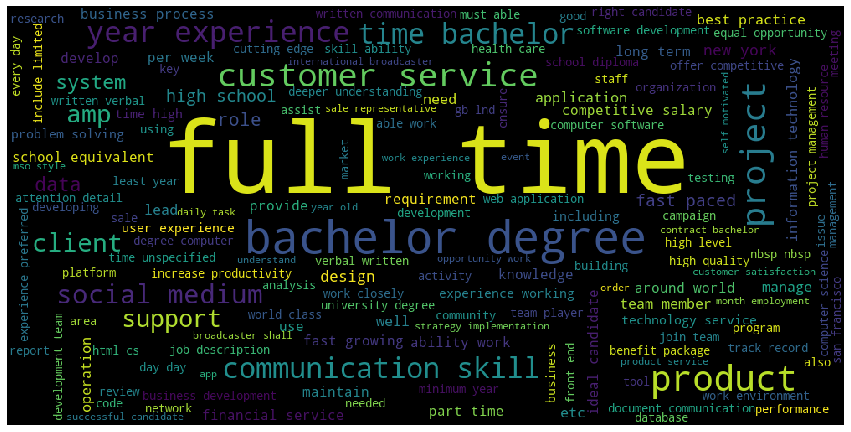

In [29]:
doc_job_fraud_0 = data.loc[data["fraudulent"] == 0]
doc_job_fraud_0 = doc_job_fraud_0["string"]

# For wordcloud we need to convert list into string because list wont work with wordcloud
doc_job_fraud_0 = "".join(doc_job_fraud_0)

# Creating wordcloud will show most frequent occuring words
import wordcloud
from wordcloud import WordCloud
import matplotlib.pyplot as plt

wordcloud = WordCloud(width=1000,height= 500,relative_scaling=1.0,max_words=3500,
                      background_color='black',
                      stopwords=stopwords,
                      min_font_size=10).generate(doc_job_fraud_0)

# plot the WordCloud image
plt.figure(figsize=(15,10), facecolor=None)
plt.imshow(wordcloud)
plt.axis("off")
plt.show()              # After executing this we will get wordcloud of most frequent words used in doc1 (for frequent words we will keep relative scaling =1)

### Wordcloud where job_fraudulet = 1

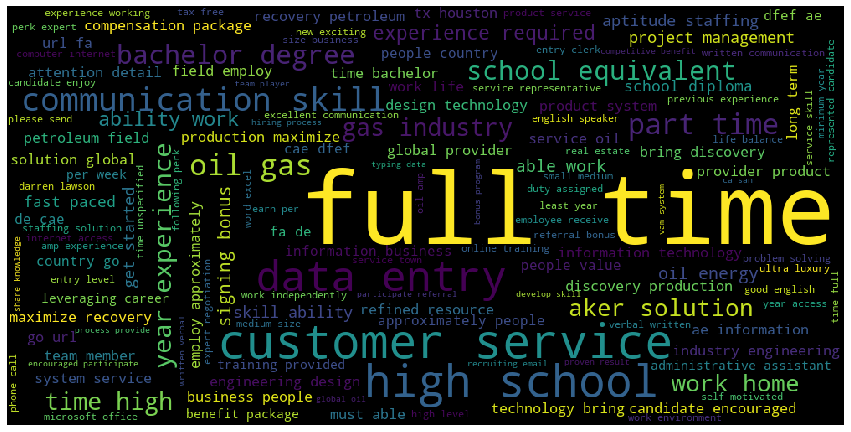

In [30]:
doc_job_fraud_1 = data.loc[data["fraudulent"] == 1]
doc_job_fraud_1 = doc_job_fraud_1["string"]

# For wordcloud we need to convert list into string because list wont work with wordcloud
doc_job_fraud_1 = "".join(doc_job_fraud_1)

# Creating wordcloud will show most frequent occuring words
import wordcloud
from wordcloud import WordCloud
import matplotlib.pyplot as plt

wordcloud = WordCloud(width=1000,height= 500,relative_scaling=1.0,max_words=3500,
                      background_color='black',
                      stopwords=stopwords,
                      min_font_size=10).generate(doc_job_fraud_1)

# plot the WordCloud image
plt.figure(figsize=(15,10), facecolor=None)
plt.imshow(wordcloud)
plt.axis("off")
plt.show()

### Creating Independent & Target variable

In [31]:
from sklearn.feature_extraction.text import CountVectorizer
cv = CountVectorizer(max_features=30000)
df = cv.fit_transform(doc).toarray()
df.shape

# converting to DataFrame for concatinating (optional)
x_df = pd.DataFrame(df)

# Independent variables
x = pd.concat([data.drop(["string","fraudulent"],axis=1),x_df],axis=1)
x.shape

# Target variable
y = data["fraudulent"]

### Spliting data into Train and Test (70:30)

In [32]:
from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=0.30,random_state=0)

### Training model with Multinomial NB

In [33]:
from sklearn.naive_bayes import MultinomialNB
classifier = MultinomialNB()
classifier.fit(x_train,y_train)

MultinomialNB(alpha=1.0, class_prior=None, fit_prior=True)

### Predicting test set results

In [34]:
y_pred = classifier.predict(x_test)
from sklearn.metrics import confusion_matrix,accuracy_score
confusion_matrix(y_test,y_pred)
accuracy_score(y_test,y_pred)
print("Accuracy with MultinomialNB is "+str(accuracy_score(y_test,y_pred)))

Accuracy with MultinomialNB is 0.9544444444444444
